# Image Analysis in python


## Setup

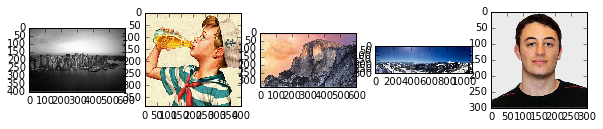

In [180]:
# Bring in necessary libraries
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
from skimage import color
import skimage.filters as filters
import skimage.exposure as exposure
import skimage.feature as feature
from skimage.transform import hough_circle
from skimage.feature import peak_local_max
from skimage import morphology
from skimage.draw import circle_perimeter
from skimage import img_as_float, img_as_ubyte, img_as_uint
from skimage import segmentation as seg
from skimage.morphology import watershed
from skimage.morphology import disk
from scipy import ndimage as nd
from scipy.ndimage import convolve
import glob # for bulk file import

# Set defaults
plt.rcParams['image.cmap'] = 'gray' # Display grayscale images in... grayscale.
plt.rcParams['image.interpolation'] = 'none' # Use nearest-neighbour
plt.rcParams['figure.figsize'] = 10, 10

# Import test images
imgpaths = glob.glob("./images/*.jpg") + glob.glob("./images/*.png")
imgset = [img_as_ubyte(mpimg.imread(x)) for x in imgpaths]

# Display thumbnails of the images to ensure loading
plt.figure()
for i,img in enumerate(imgset):
    plt.subplot(1, len(imgset), i+1)
    plt.imshow(img, cmap = 'gray')

## Color and Exposure

### Histograms and color channels

In [2]:
# Plots a histogram of the image, splitting into individual channels if necessary.
def plot_multichannel_histo(img):
    if img.ndim == 2: # plot grayscale histo
        plt.hist(img.flatten(), 256,  range=(0,255), color='k', histtype='step')
    elif img.ndim == 3: # print rgb histo
        plt.hist(img.reshape(-1,3), 256,  range=(0,255), color=['r','g','b'],histtype='step')
    else: # Not an image
        print("Must pass a valid RGB or grayscale image")
    plt.xlim([0,255])

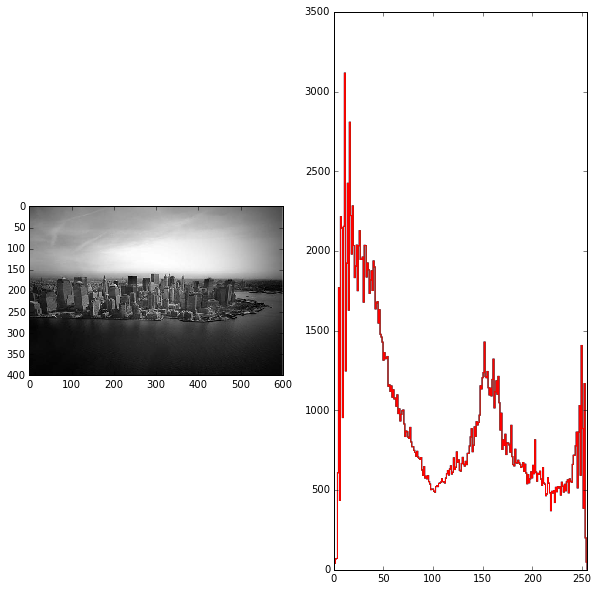

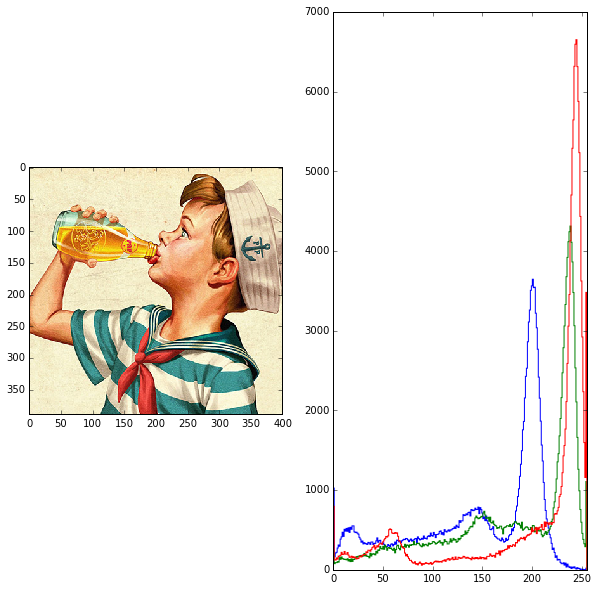

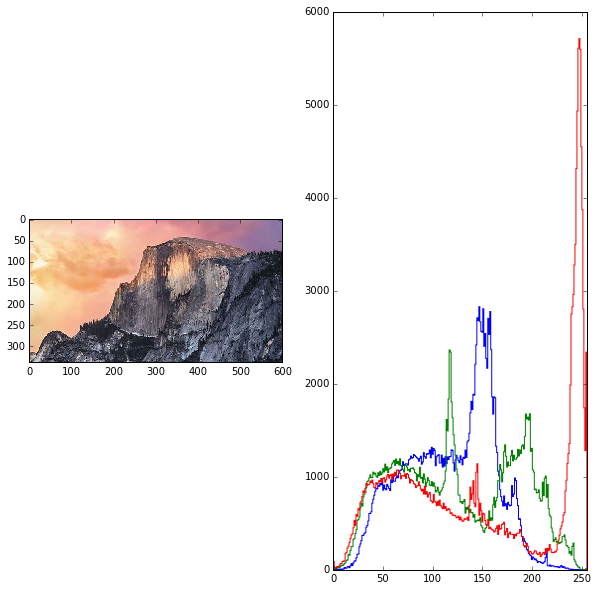

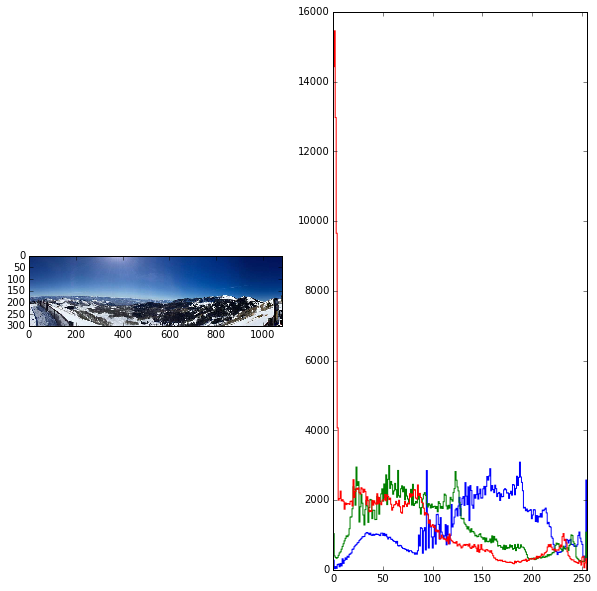

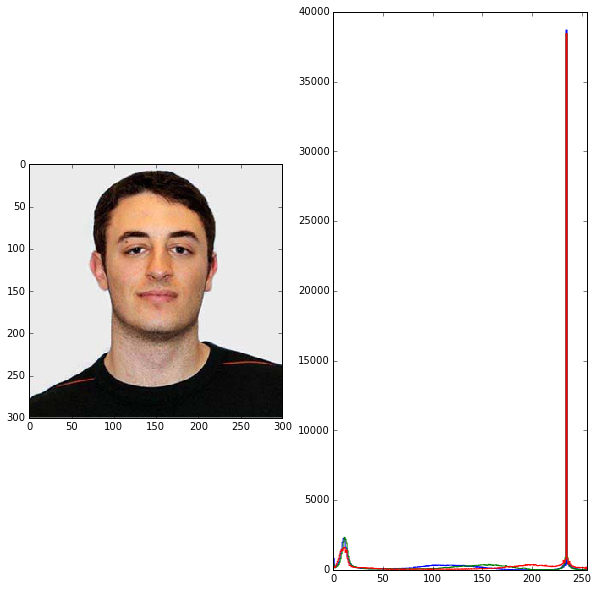

In [3]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.subplot(1, 2, 2)
    plot_multichannel_histo(img)

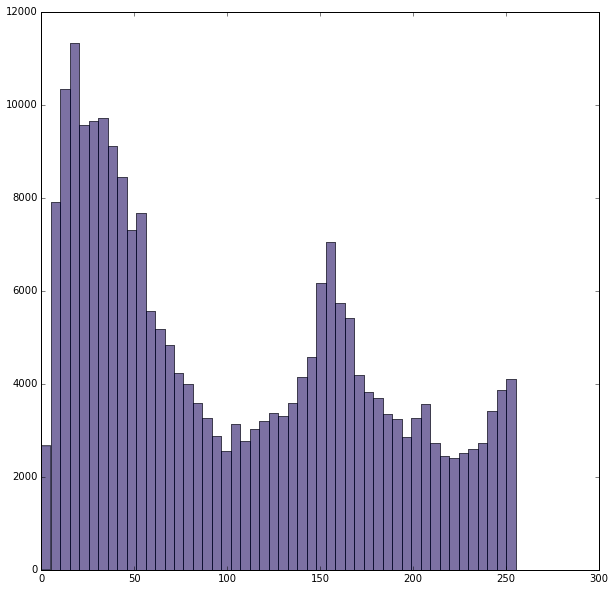

In [4]:
# Alternate histogram syntax
for col, channel in zip('rgb',np.rollaxis(imgset[0],axis=-1)):
    plt.hist(channel.flatten(), bins=50, color=col,alpha=0.3)

### Thresholding Images 

In [52]:
# Plot a per-channel thresholded image and its corresponding histogram
# abarba - if a pixel is below the threshold, replace with a black pixes, if above replace with white pixel
def plot_threshold_with_histo(img, thresh):
    plt.subplot(1, 2, 1)
    plt.imshow(img > thresh)
    plt.subplot(1, 2, 2)
    plot_multichannel_histo(img)
    plt.axvline(thresh, color='red');

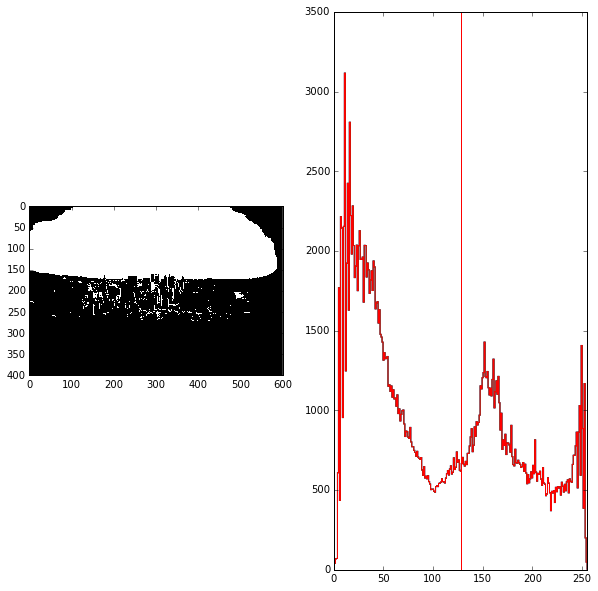

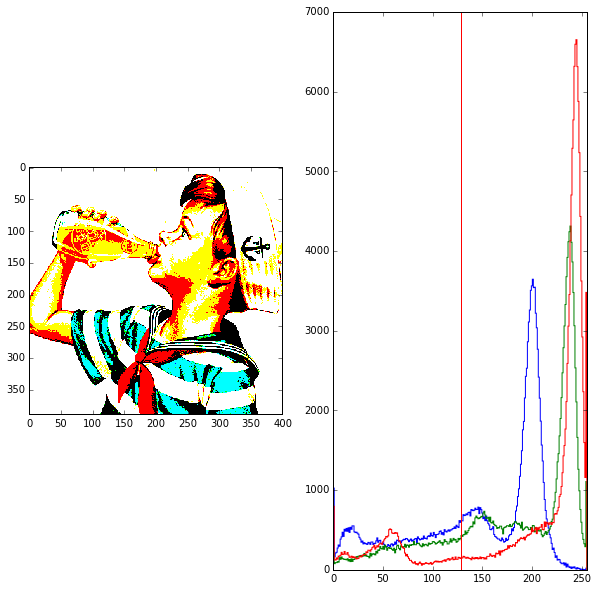

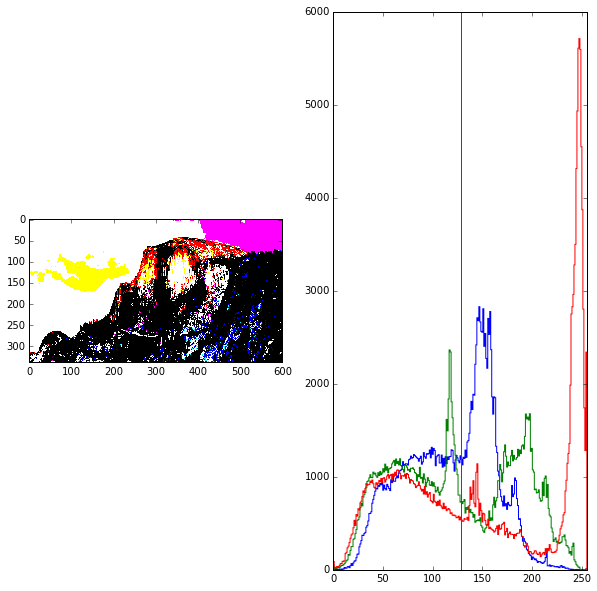

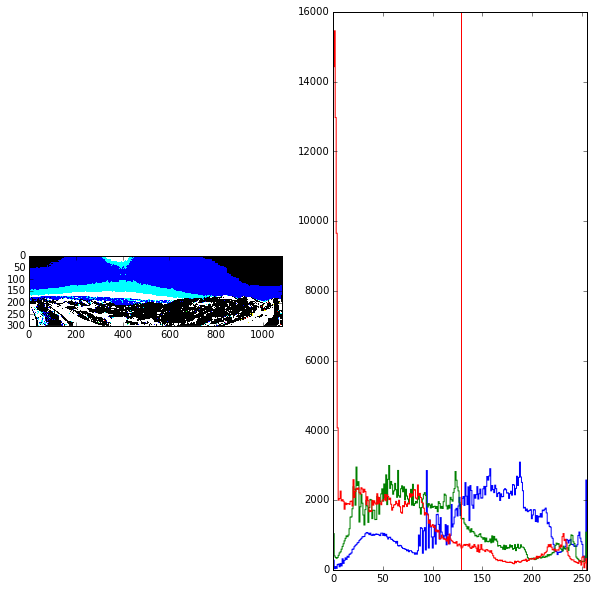

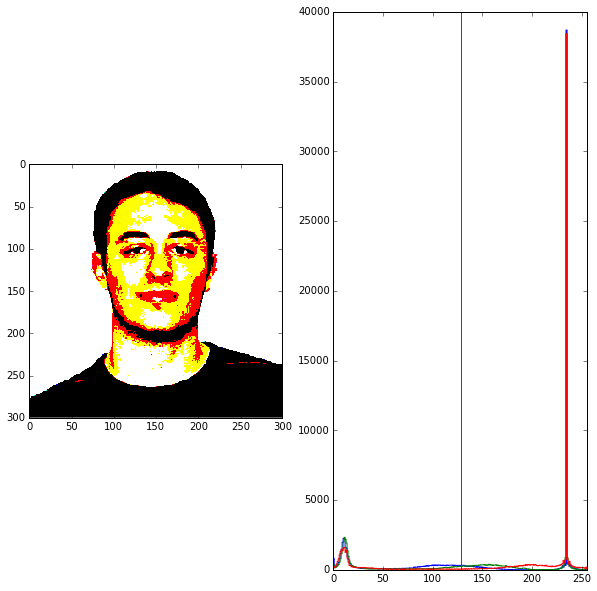

In [54]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plot_threshold_with_histo(img, 128)

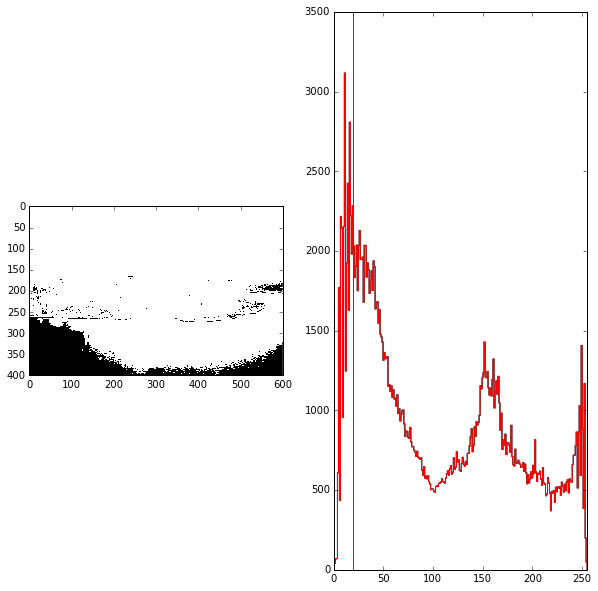

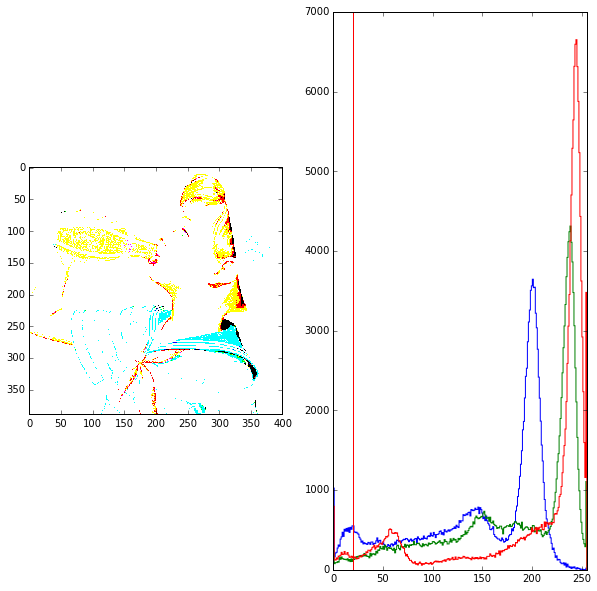

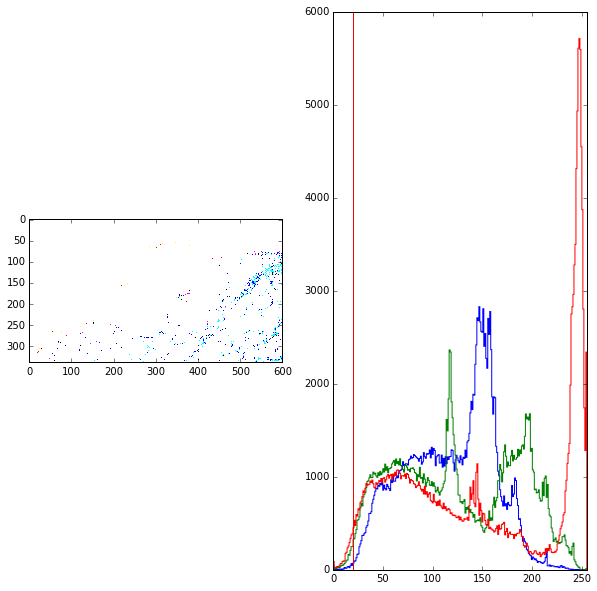

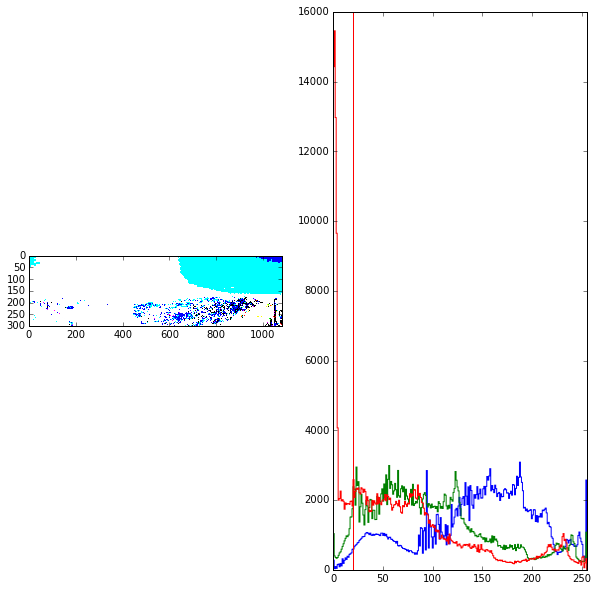

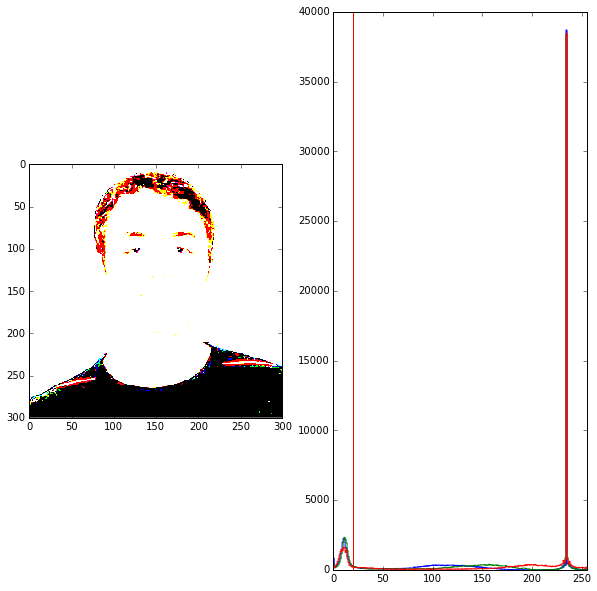

In [55]:
# Apply to image set - trial 1
for i,img in enumerate(imgset):
    plt.figure()
    plot_threshold_with_histo(img, 20)

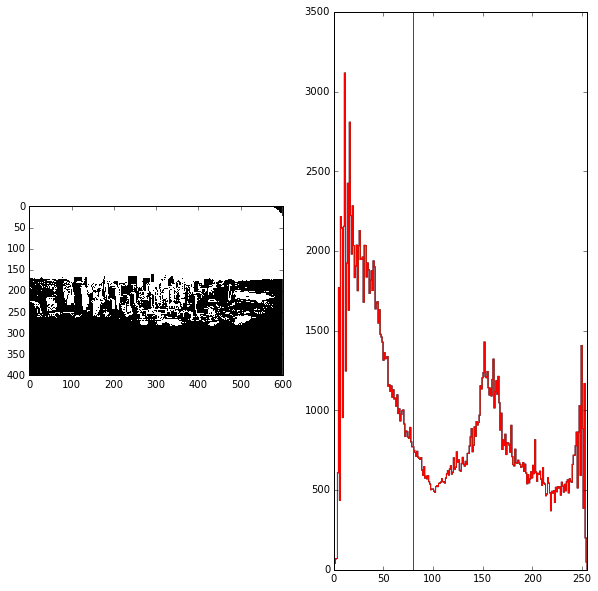

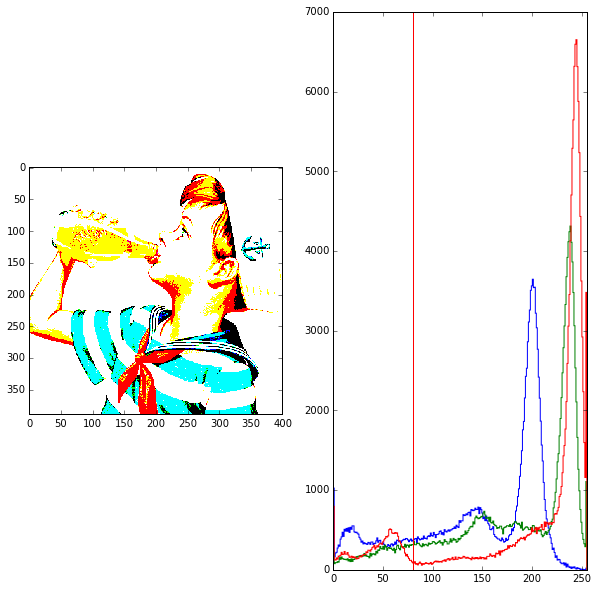

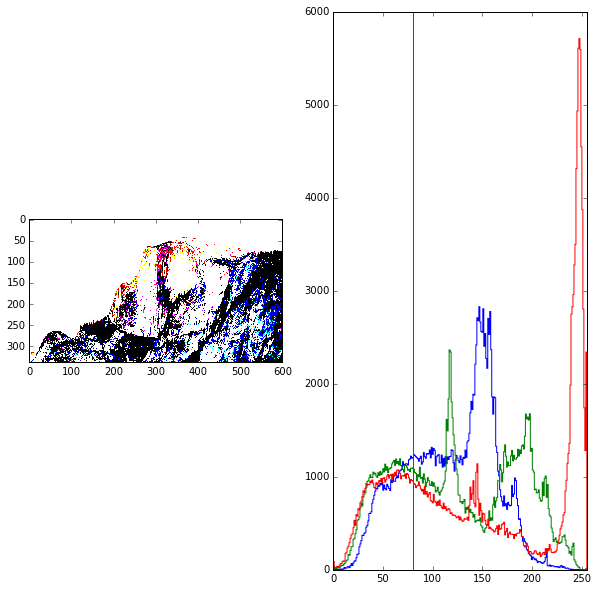

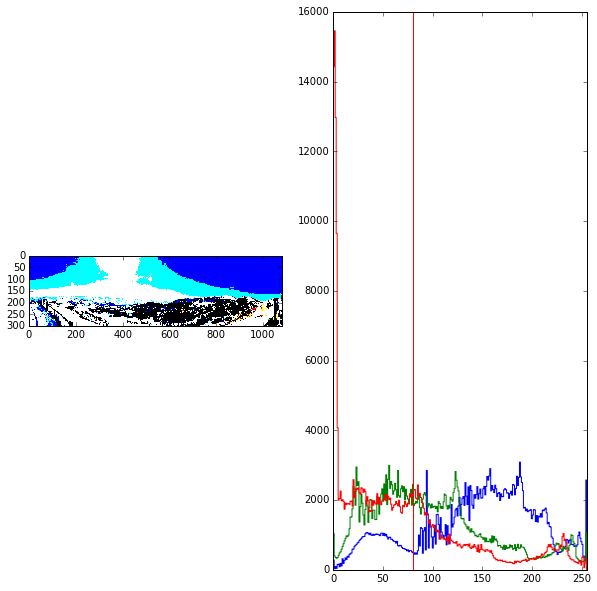

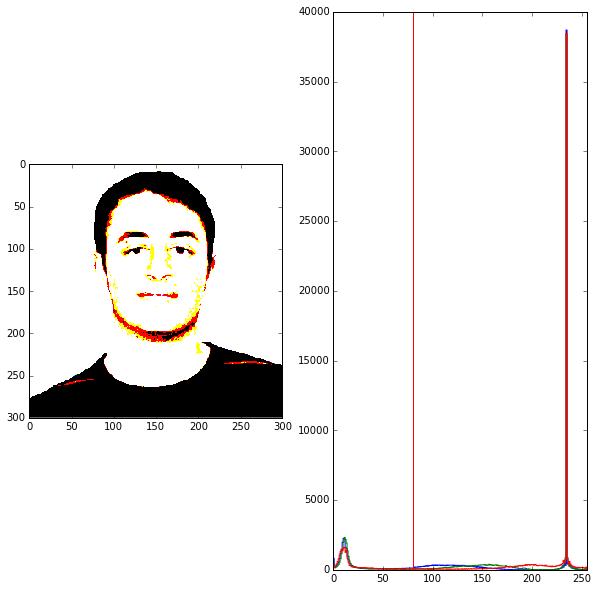

In [56]:
# Apply to image set - trial 2
for i,img in enumerate(imgset):
    plt.figure()
    plot_threshold_with_histo(img, 80)

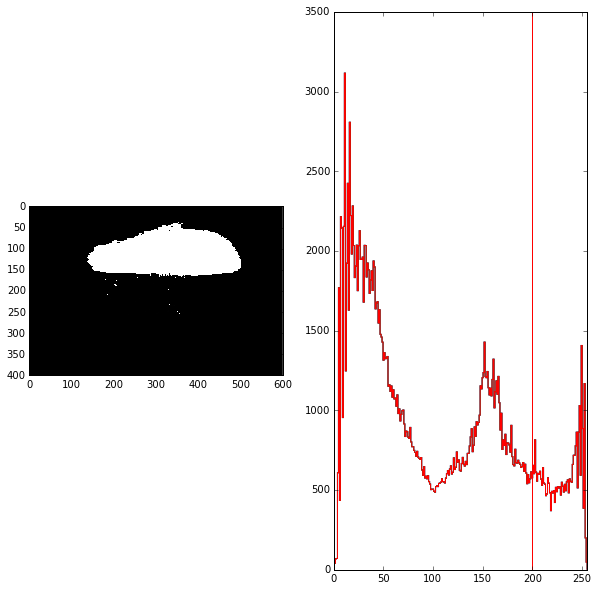

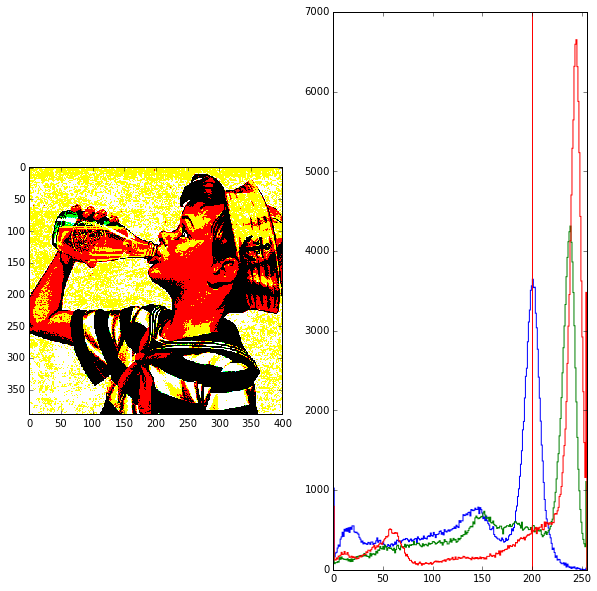

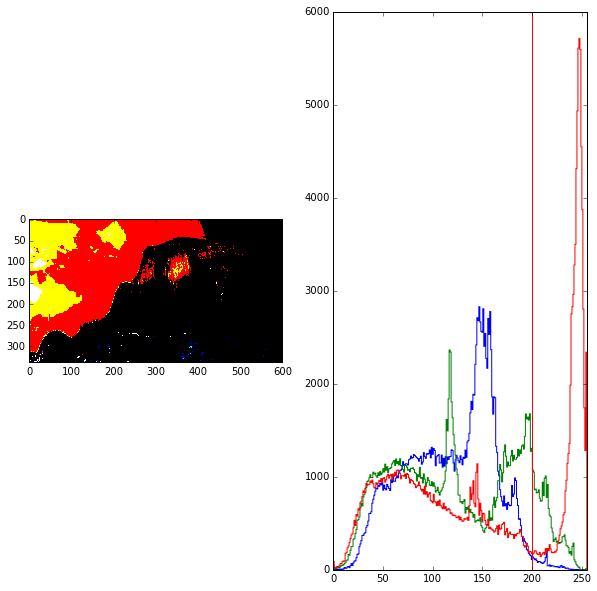

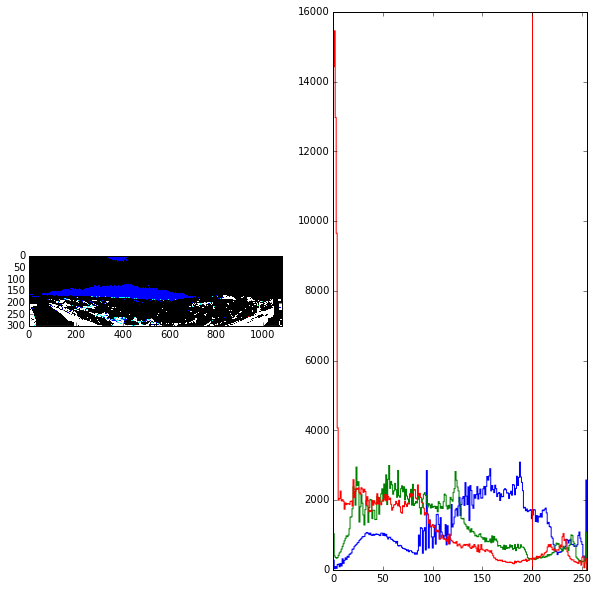

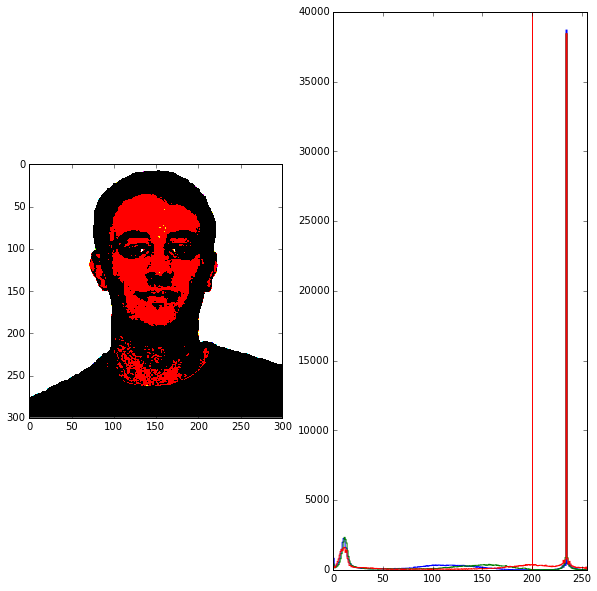

In [57]:
# Apply to image set - trial 3
for i,img in enumerate(imgset):
    plt.figure()
    plot_threshold_with_histo(img, 200)

### Sepia and color filters

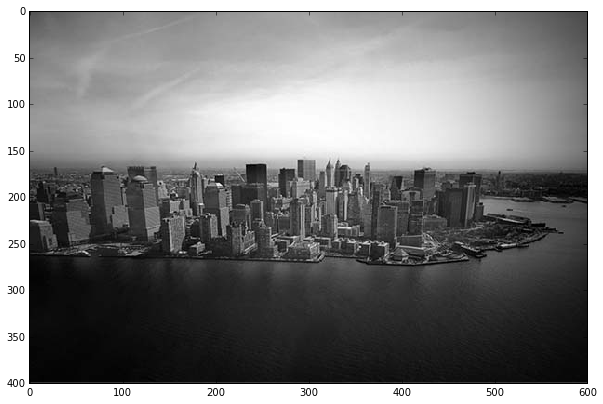

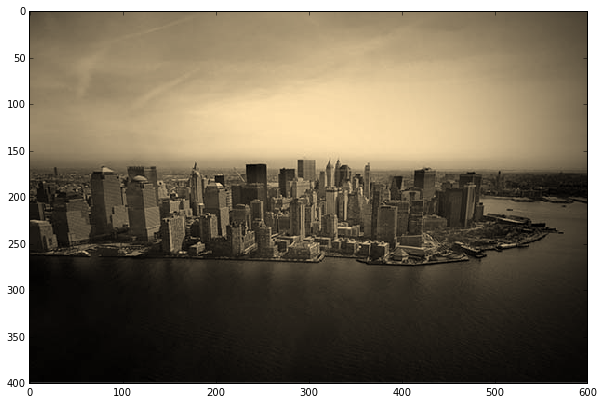

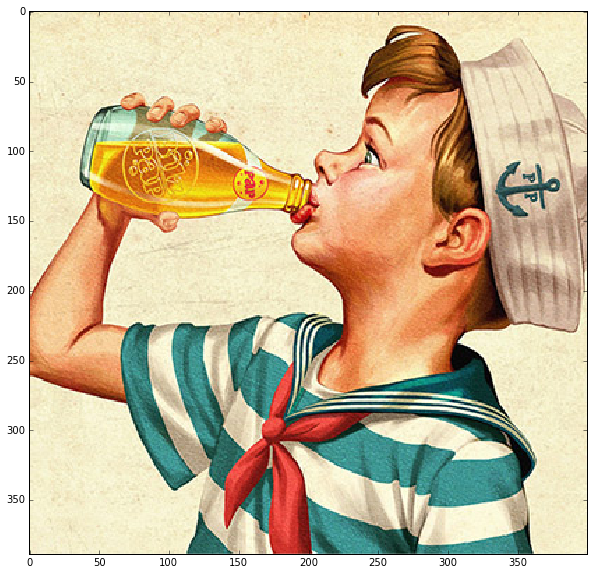

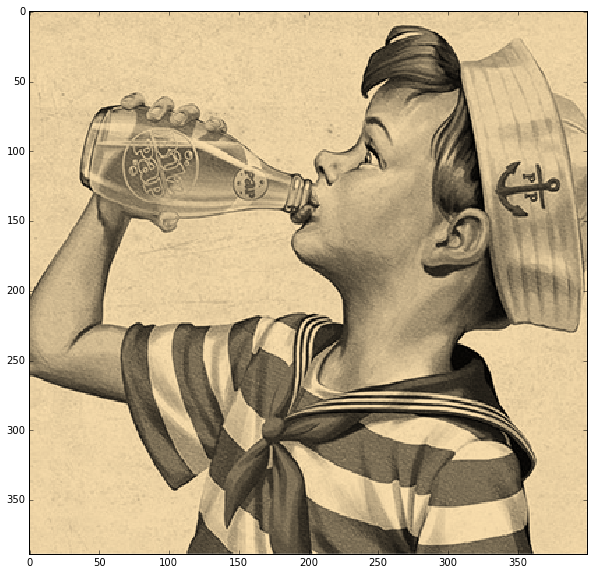

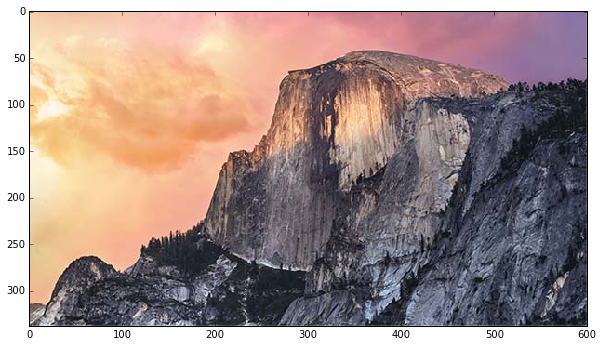

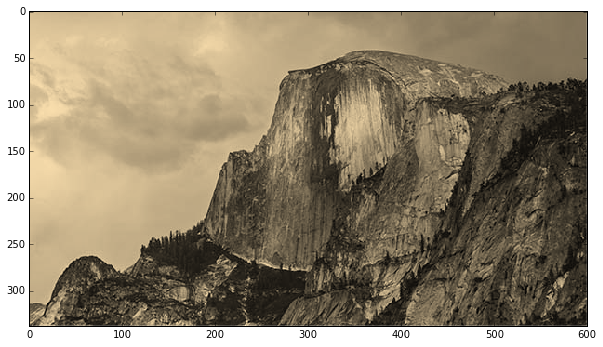

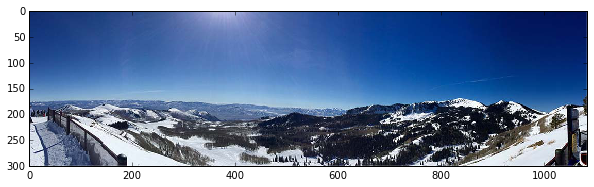

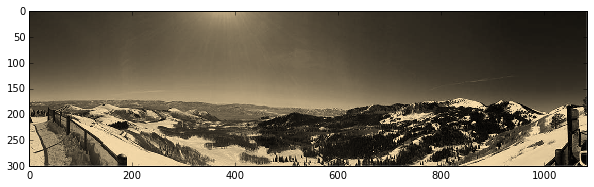

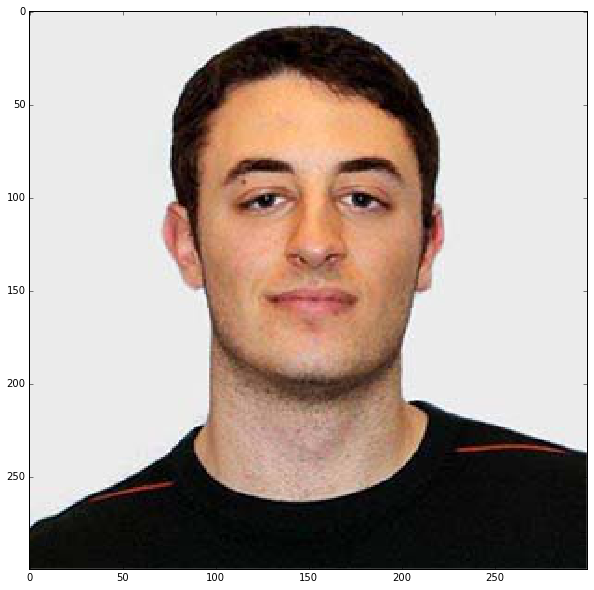

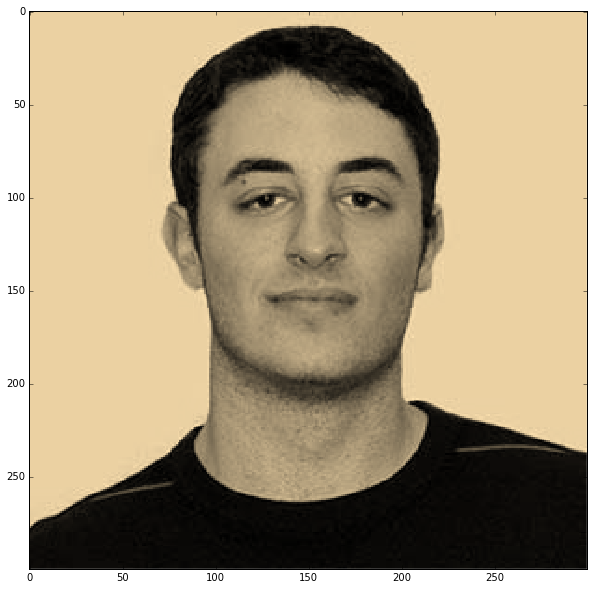

In [67]:
# Sepia and color filters
# abarba - the columns of the matrix the input red, green, blue of each pixel multipied by the value
# abarba - the rows of the matrix are the output red, green, blue where each value in the row is added together
def sepia_filter(img):
  #create a kernel which will be used to the original image.
  sepia_filter = np.array([[.393, .769, .189],
                           [.349, .686, .168],
                           [.272, .534, .131]])
  #Dot product the image and array
  #T is the transpose of the array.
  sepia_img = img.dot(sepia_filter.T)

  #Since our filter lines do not have unit sum, so we need to rescale
  sepia_img /= sepia_img.max()
  return sepia_img

for i,img in enumerate(imgset):
    sepia = sepia_filter(img)
    plt.imshow(img)
    plt.show()
    plt.imshow(sepia)
    plt.show()    


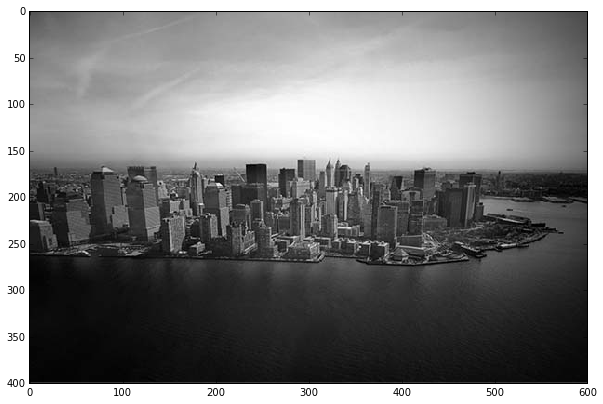

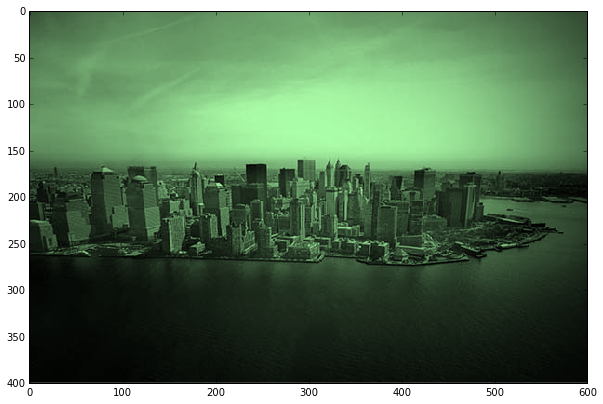

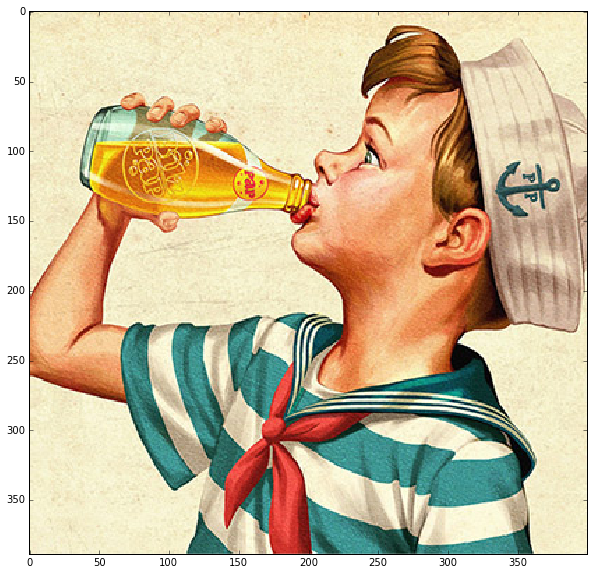

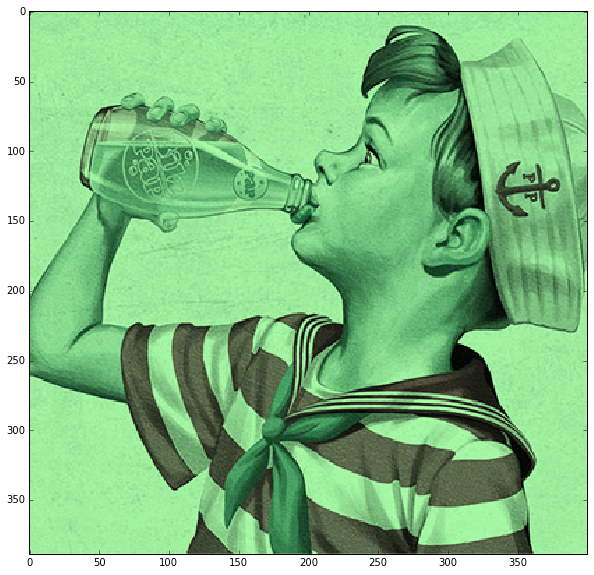

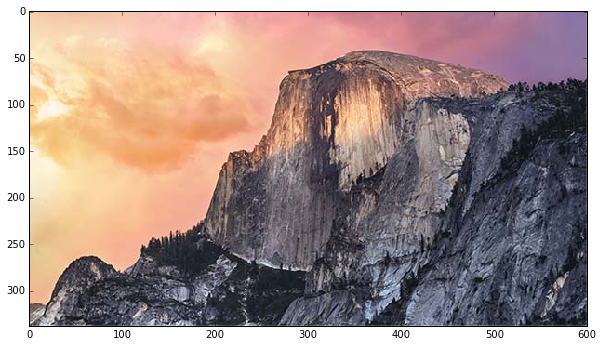

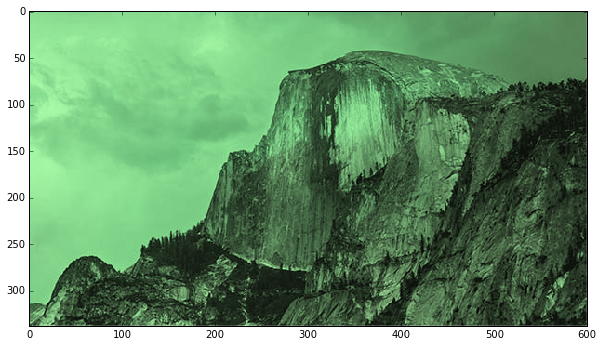

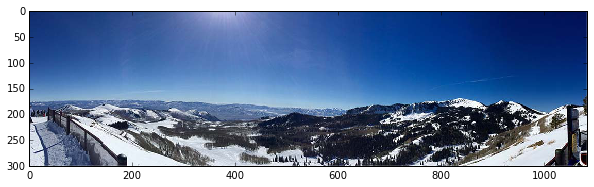

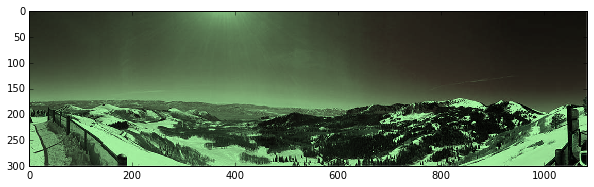

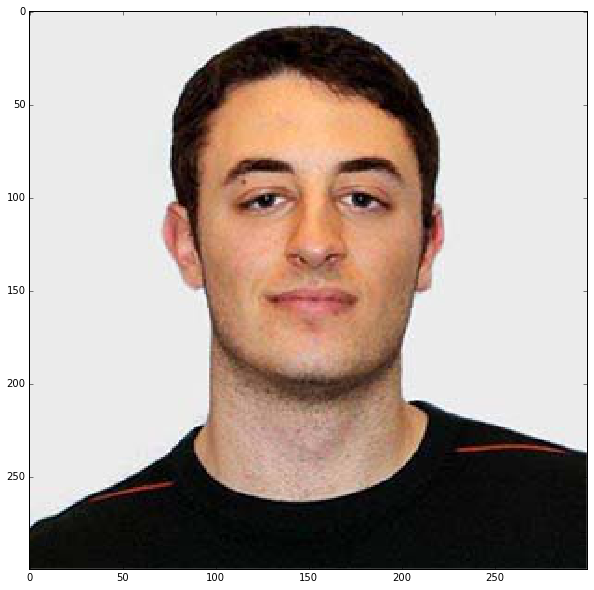

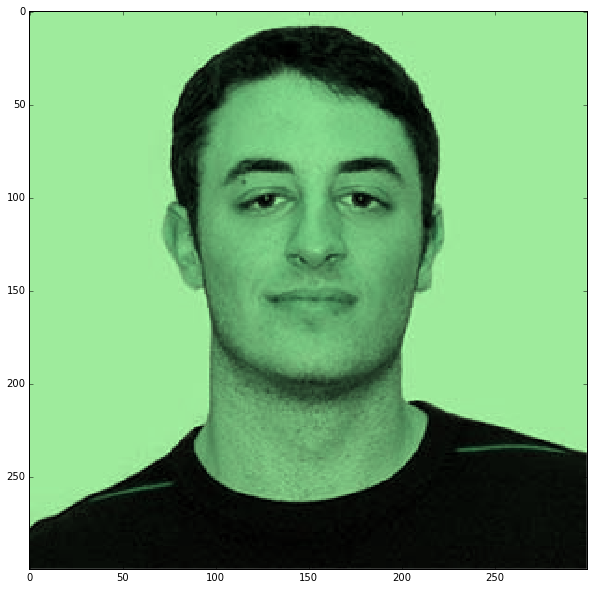

In [60]:
# Sepia-Green and color filters
def sepia_green_filter(img):
  #create a kernel which will be used to the original image.
  sepia_green_filter = np.array([[.193, .769, .189],
                                 [.849, .686, .168],
                                 [.472, .534, .131]])
  #Dot product the image and array
  #T is the transpose of the array.
  sepia_img = img.dot(sepia_green_filter.T)

  #Since our filter lines do not have unit sum, so we need to rescale
  sepia_img /= sepia_img.max()
  return sepia_img

for i,img in enumerate(imgset):
    sepia_green = sepia_green_filter(img)
    plt.imshow(img)
    plt.show()
    plt.imshow(sepia_green)
    plt.show() 

### Enhance Contrast

/Users/abarba/anaconda/lib/python2.7/site-packages/skimage/util/dtype.py:111: UserWarning: Possible precision loss when converting from float64 to uint8
  "%s to %s" % (dtypeobj_in, dtypeobj))


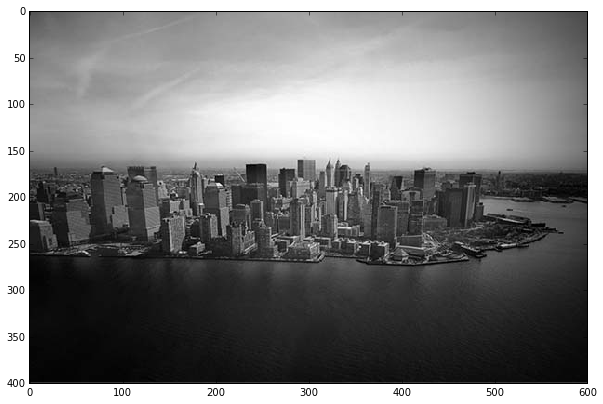

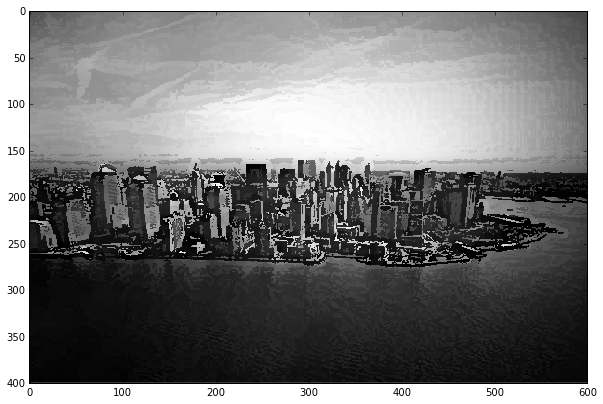

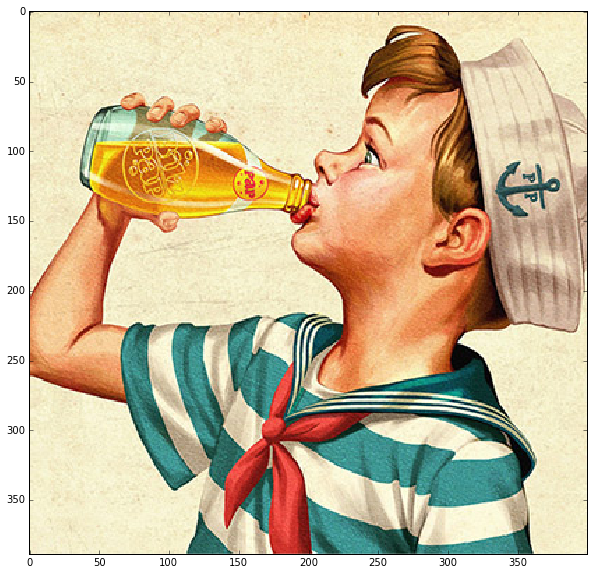

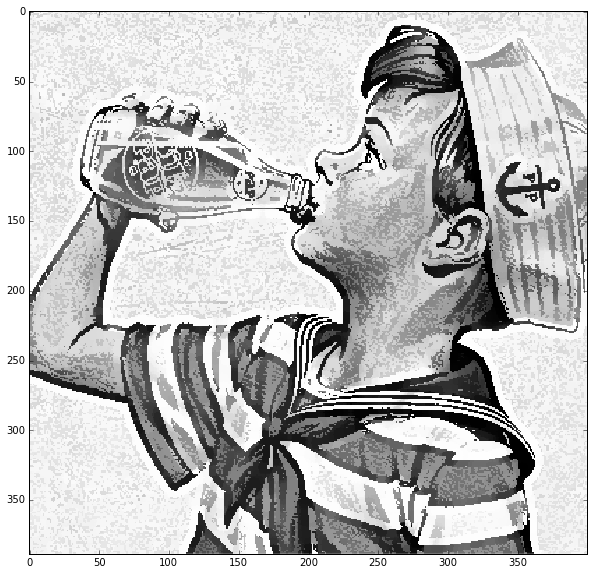

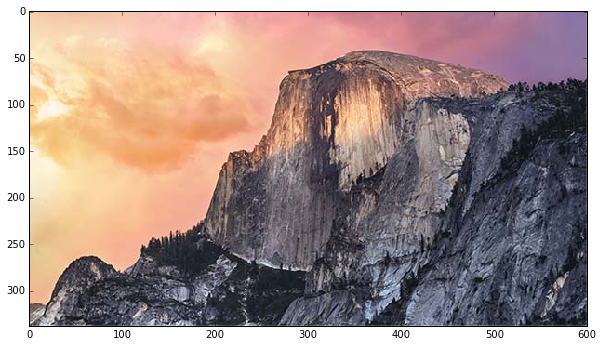

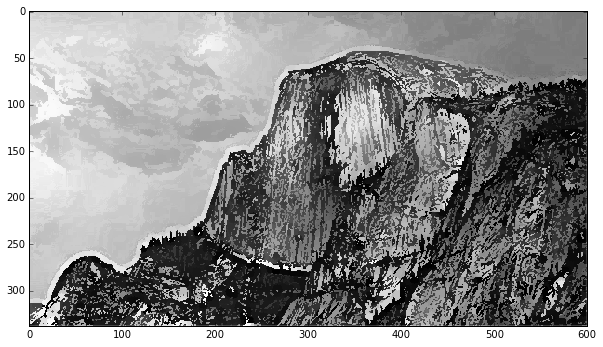

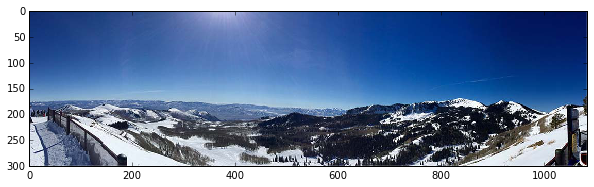

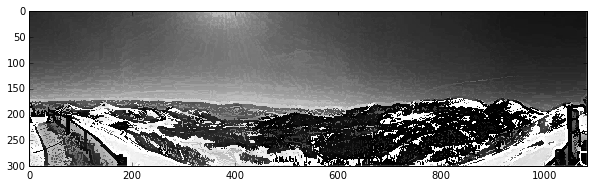

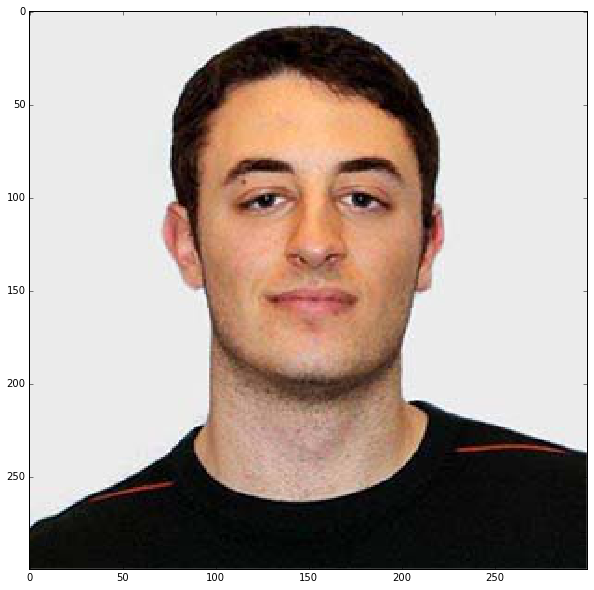

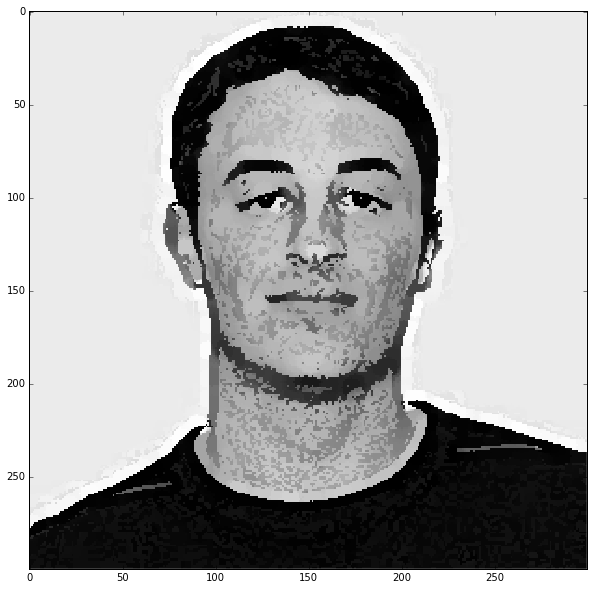

In [8]:
# Enhance Contrast
# abarba - multiple darker pixels to be darker and brighter pixels to be brighter
# abarba - in my case, most images hit a threshold and came out black and white
def boost_contrast(img):
    if img.ndim == 3:
        img = color.rgb2grey(img) 
    ent = filters.rank.enhance_contrast(img_as_ubyte(img), disk(5))
    return ent

for i,img in enumerate(imgset):
    new = boost_contrast(img)
    plt.imshow(img)
    plt.show()
    plt.imshow(new)
    plt.show()  

### Add entropy

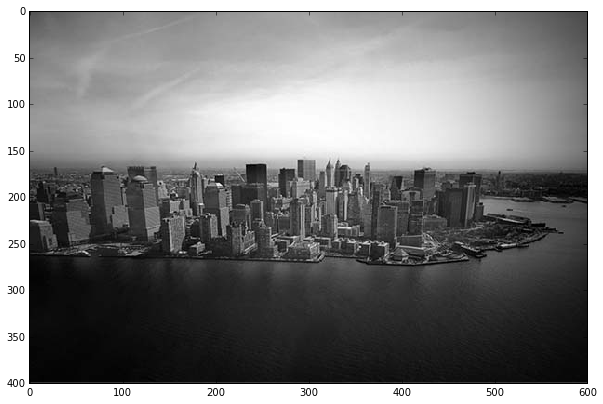

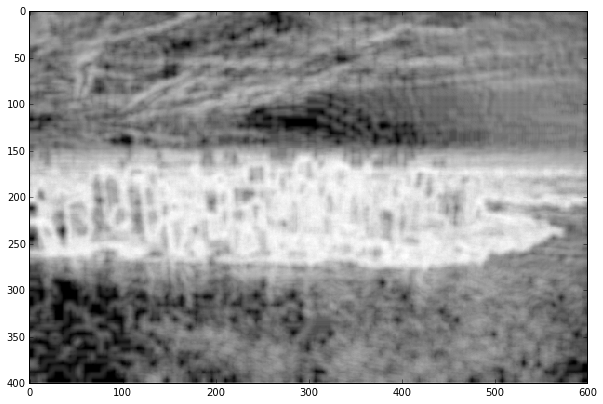

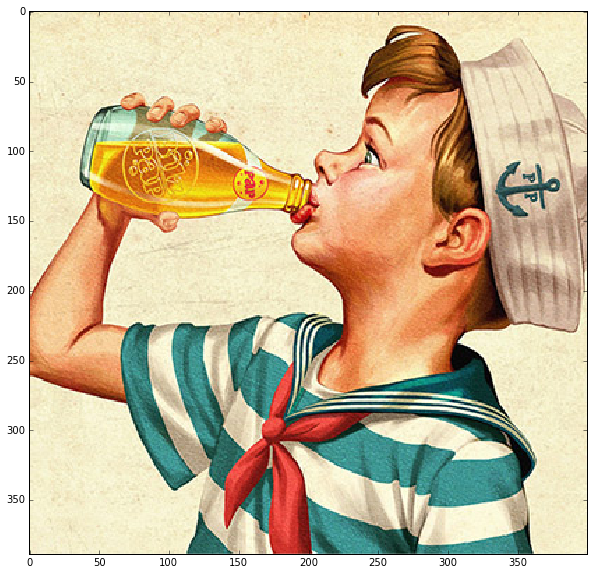

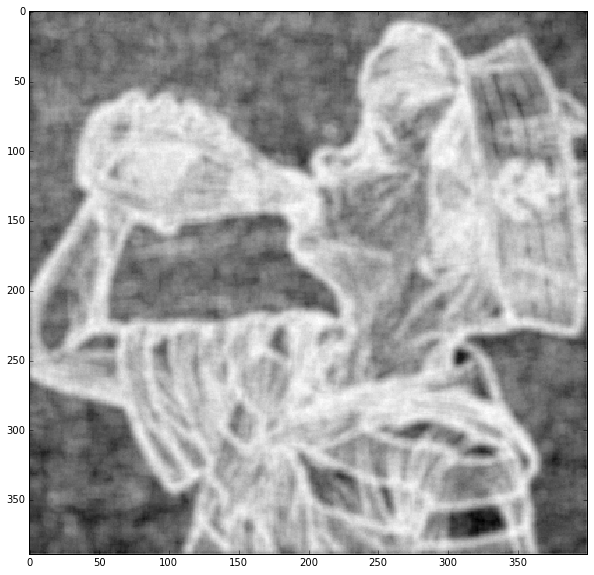

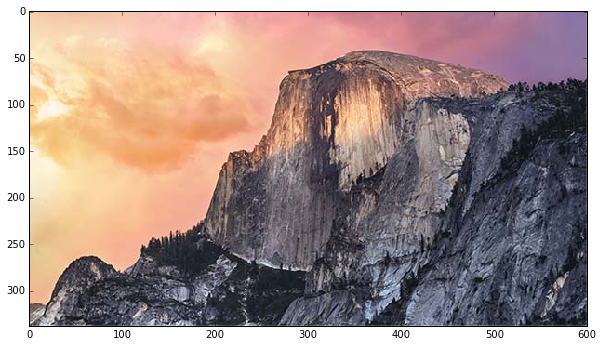

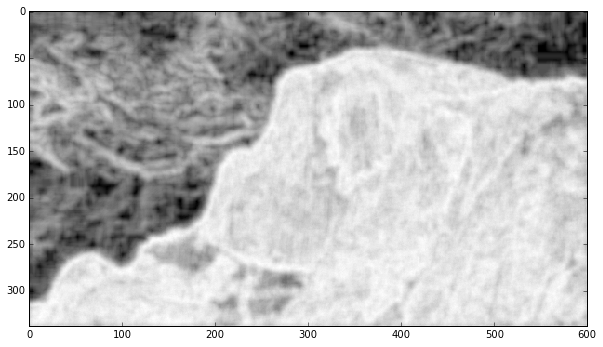

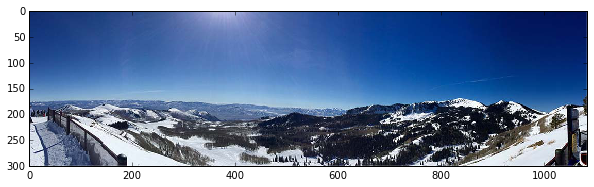

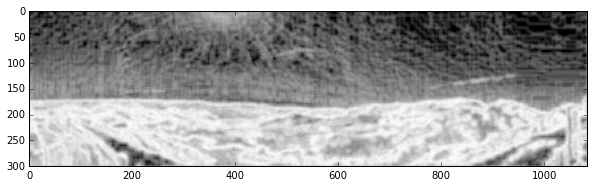

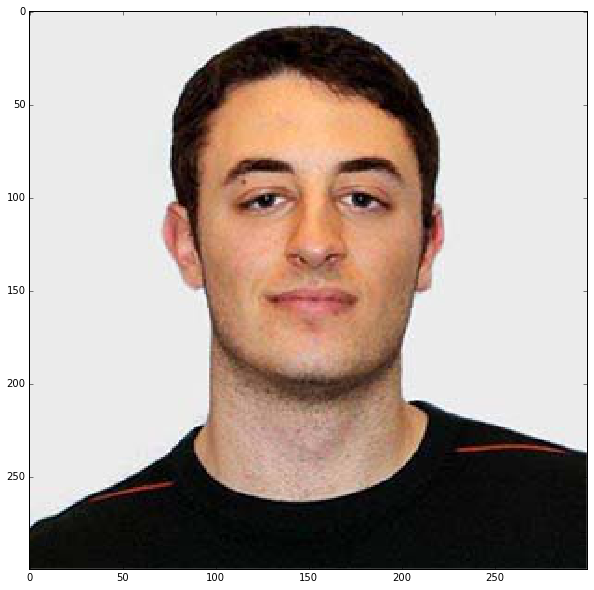

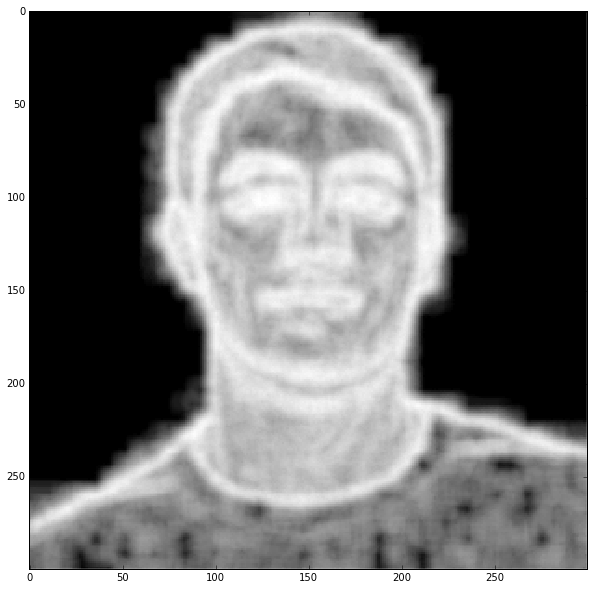

In [9]:
# Add entropy
# abarba - adding entropy will add randomness to each pixels position and size
# abarba - this creates a blurred image where you can make out the outline of the most distinct lines
def add_entropy(img):
    if img.ndim == 3:
        img = color.rgb2grey(img) 
    ent = filters.rank.entropy(img_as_ubyte(img), disk(5))
    return ent

for i,img in enumerate(imgset):
    new = add_entropy(img)
    plt.imshow(img)
    plt.show()
    plt.imshow(new)
    plt.show()  

### H, S and V color space

In [10]:
# Show HSV as three plots
# abarba - plots three images representing the hue saturation and value of each image
# abarba - hue is the amount of pur color in each pixel (black and white will return 0 which is red)
# abarba - saturation is how white each pixel is where pure red is considered fully saturated
# abarba - value is how bright each pixel is where black is a value of 0
def plot_hsv_components(img):
    if img.ndim == 2: # convert grayscale to rgb
        hsv = color.rgb2hsv(color.gray2rgb(img))
    elif img.ndim == 3:
        hsv = color.rgb2hsv(img)
    else: # Not an image
        print("Must pass a valid RGB or grayscale image")
    plt.subplot(1, 3, 1)
    plt.title('Hue')
    plt.imshow(hsv[:,:,0], cmap='hsv') # Hue
    plt.subplot(1, 3, 2)
    plt.title('Saturation')
    plt.imshow(hsv[:,:,1], cmap='Greens') # Sat
    plt.subplot(1, 3, 3)
    plt.title('Value')
    plt.imshow(hsv[:,:,2], cmap='gray') # Value

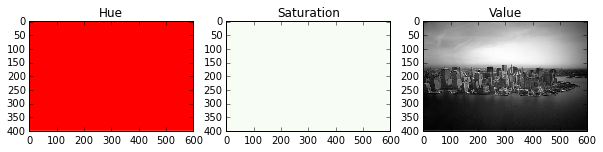

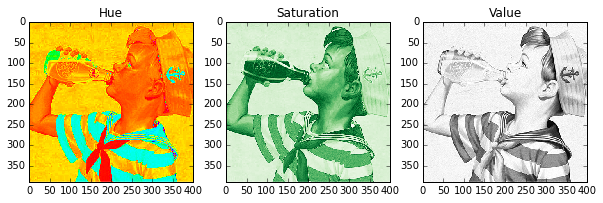

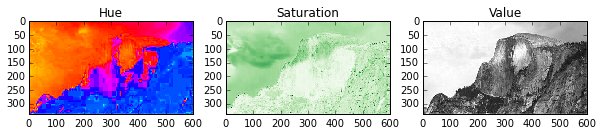

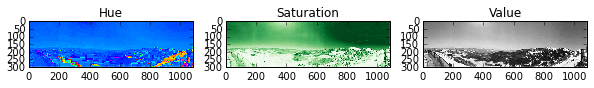

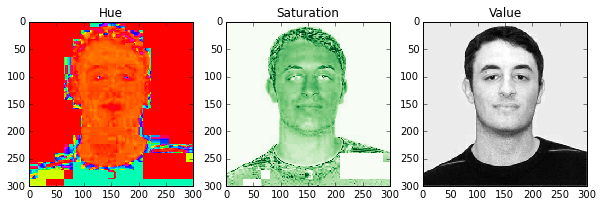

In [11]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plot_hsv_components(img)

### CIELAB color space. L, a, b channels

In [12]:
# Show Lab as three plots
def plot_Lab_components(img):
    if img.ndim == 2: # convert grayscale to Lab
        lab = color.rgb2lab(color.gray2rgb(img))
    elif img.ndim == 3:
        lab = color.rgb2lab(img)
    else: # Not an image
        print("Must pass a valid RGB or grayscale image")
    plt.subplot(1, 3, 1)
    plt.title('L')
    plt.imshow(lab[:,:,0]) # L
    plt.subplot(1, 3, 2)
    plt.title('a')
    plt.imshow(lab[:,:,1]) # a
    plt.subplot(1, 3, 3)
    plt.title('b')
    plt.imshow(lab[:,:,2]) # b

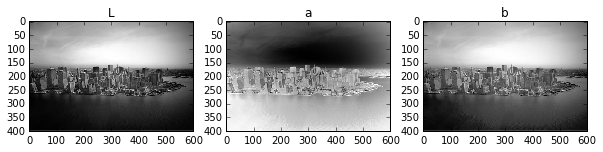

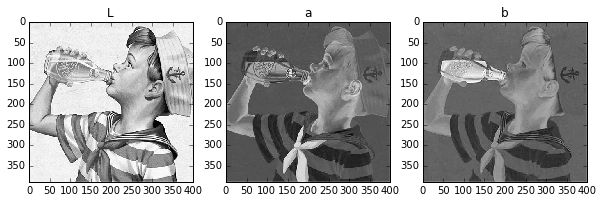

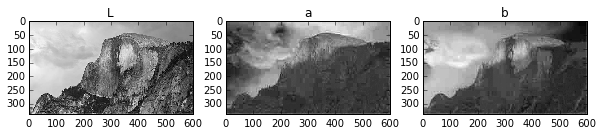

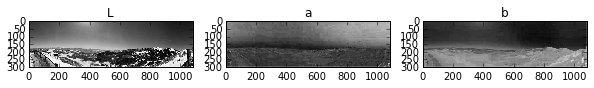

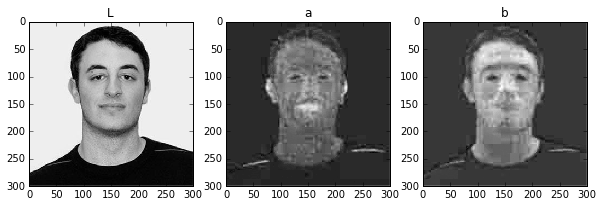

In [13]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plot_Lab_components(img)

# Image Filters - Convolution of kernels

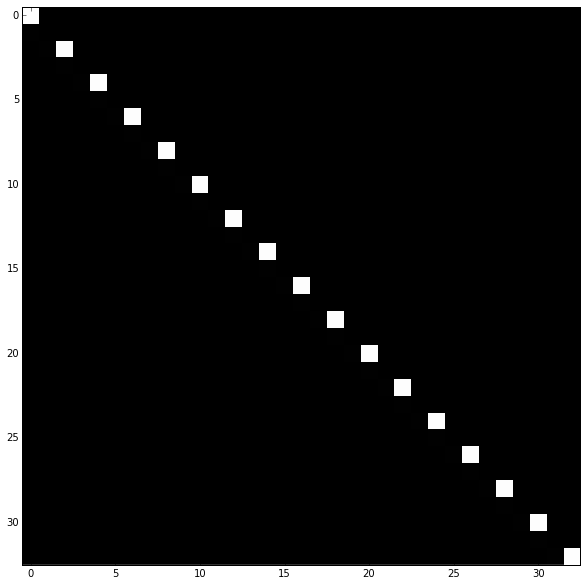

In [14]:
# Create some arbitrary kernel
def generate_kernel(size):
    kernel = np.zeros((size,size))
    for x in range(size):
        if x%2==0:
          kernel[x][x] = 1.0    
    kernel = kernel / float(sum(sum(kernel)))
    return kernel

kernel = generate_kernel(33)
plt.imshow(kernel)

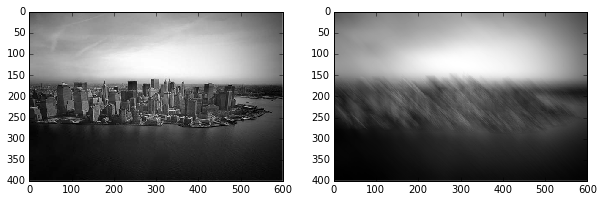

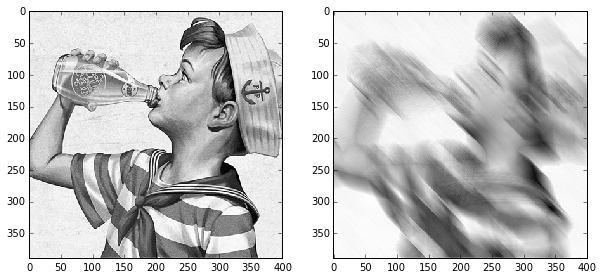

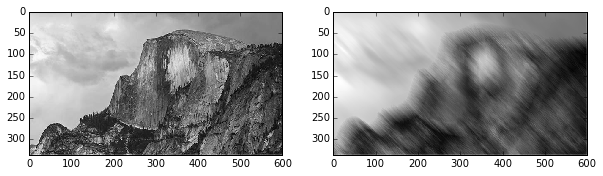

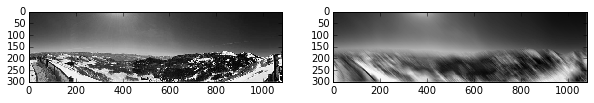

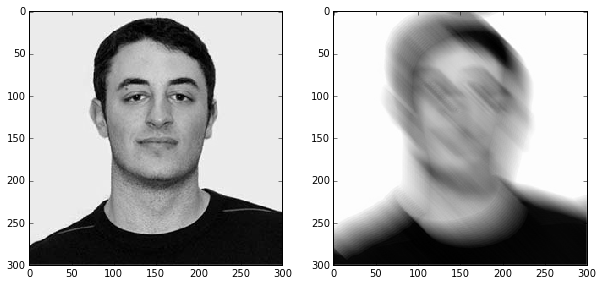

In [15]:
# Apply to image set
for i,img in enumerate(imgset):
    imgbw = color.rgb2grey(img)
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 2, 2)
    plt.imshow(convolve(imgbw, kernel))

## Downsampling

In [16]:
# Downsample an image by skipping indicies
# abarba - effectively converts the image to a lower resolution
# abarba - skips over `skip` number of pixels and returns just that pixel
# abarba - ex. skip of 2 will decrease the resolution by a factor of 4. 1/2 height and 1/2 width
def decimate_image(img, skip):
     return img[::skip,::skip]

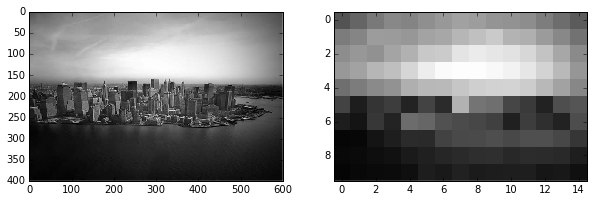

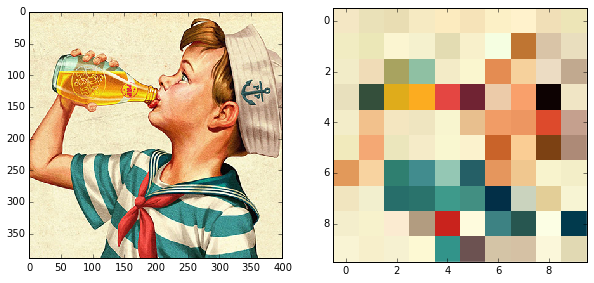

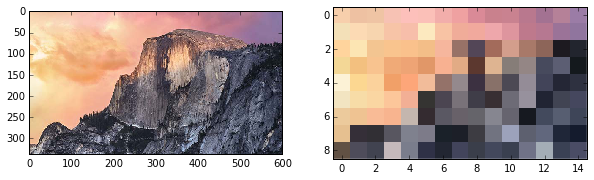

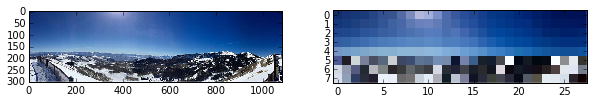

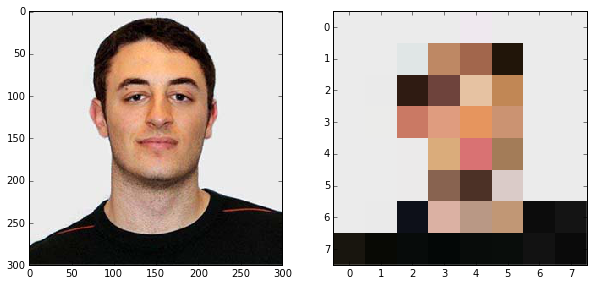

In [68]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(decimate_image(img, 40))

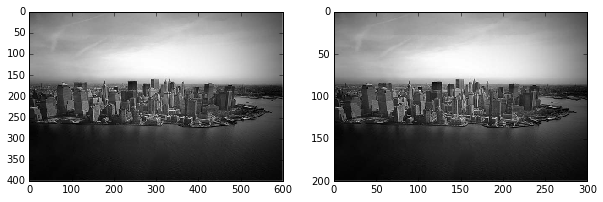

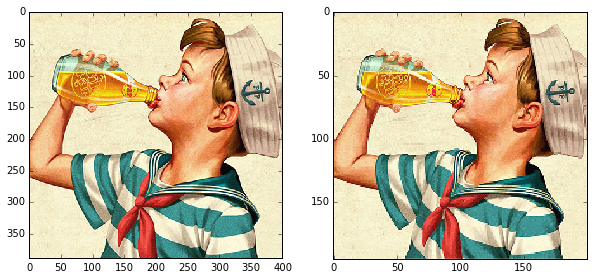

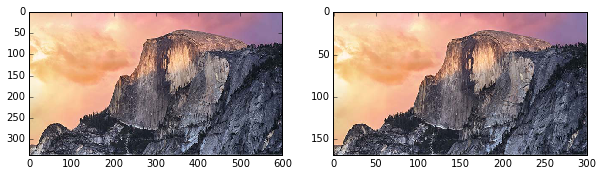

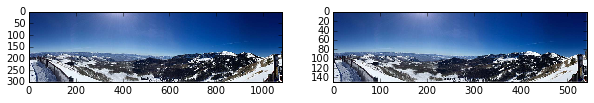

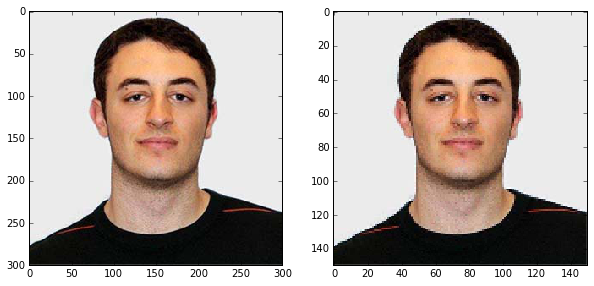

In [74]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(decimate_image(img, 2))

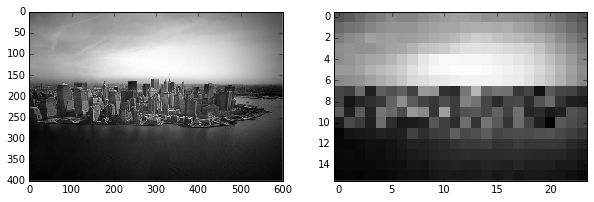

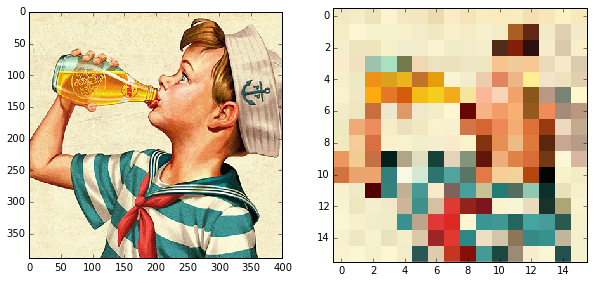

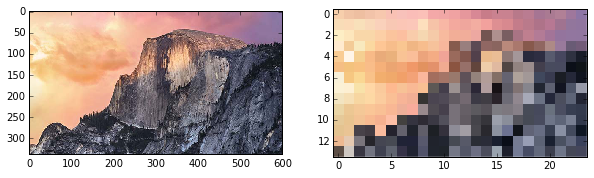

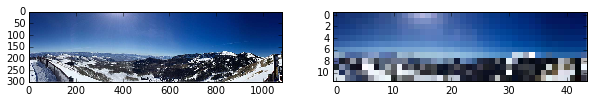

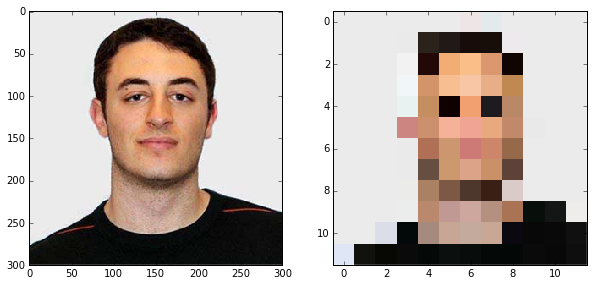

In [70]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(decimate_image(img, 25))

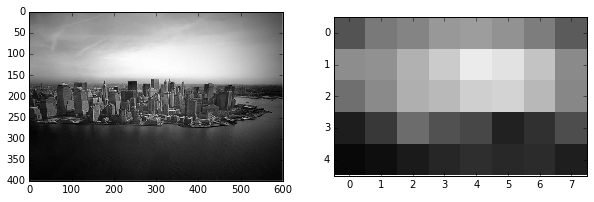

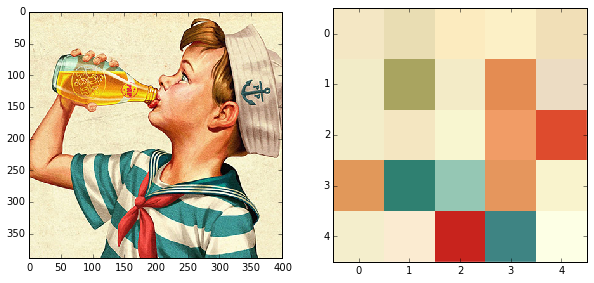

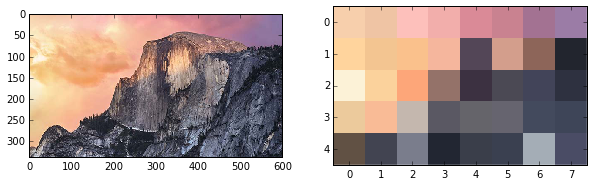

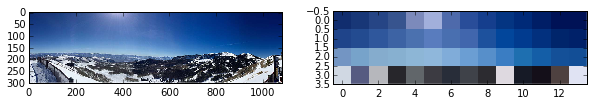

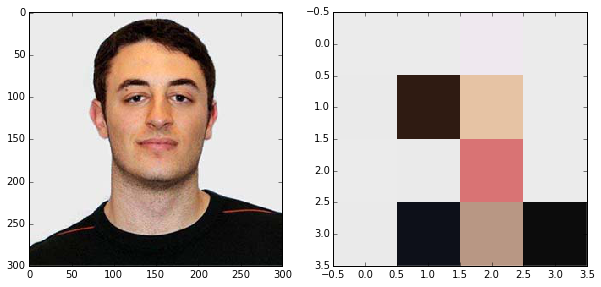

In [71]:
# Apply to image set
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(decimate_image(img, 80))

## Gaussian filters

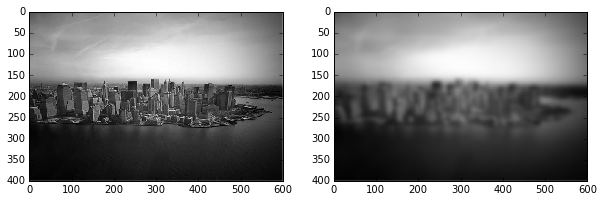

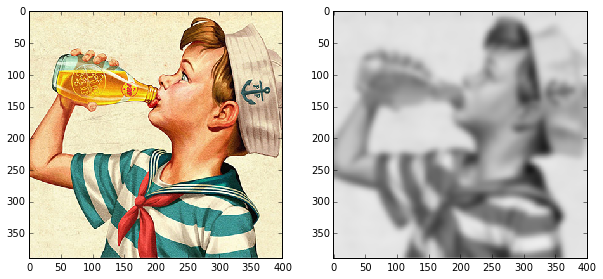

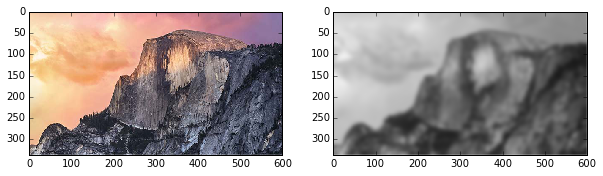

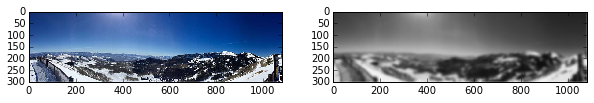

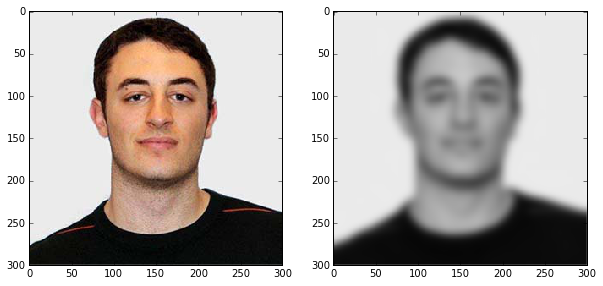

In [76]:
# Apply to image set
# abarba - blurs a grouping of every `sigma` pixels. 
# abarba - 1 is essentially no blur, where `sigme` === `width` is a complete blur producing 1 color
sigma = 5.0
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(filters.gaussian_filter(img, sigma,mode='reflect', multichannel=False))

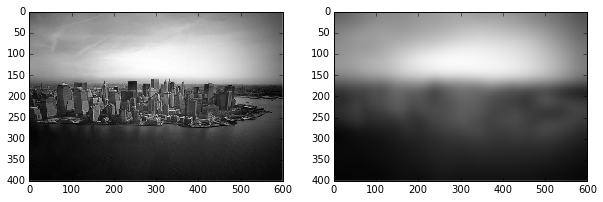

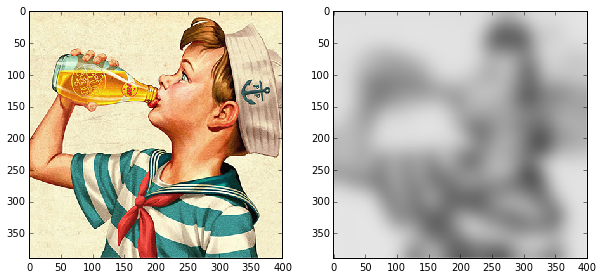

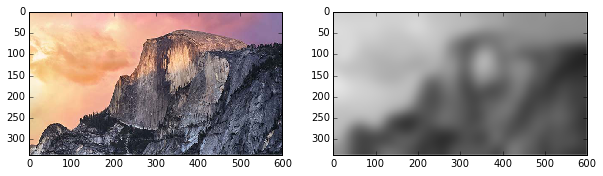

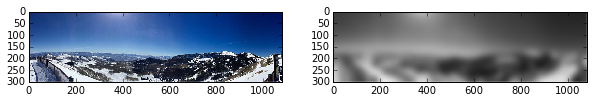

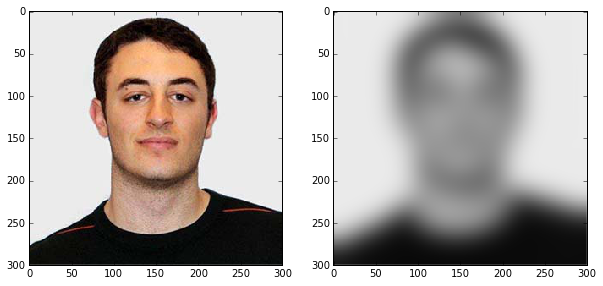

In [19]:
# Apply to image set
sigma = 15.0
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(filters.gaussian_filter(img, sigma,mode='reflect', multichannel=False))

## Spatial difference filters

In [20]:
# Find horizontal edges using a simple shifting method
# abarba - finds multiple pixels left and right of each other that are the same color. 
# abarba - Those groups become white, all of other pixels become black
def find_horizontal_edges(img):
    imgbw = img_as_float(color.rgb2grey(img))
    return np.abs(imgbw[:, 1:] - imgbw[:, :-1])

# Find vertical edges using a simple shifting method
# abarba - finds multiple pixels above and below each other that are the same color. 
# abarba - Those groups become white, all of other pixels become black
def find_vertical_edges(img):
    imgbw = img_as_float(color.rgb2grey(img))
    return np.abs(imgbw[1:, :] - imgbw[:-1, :])

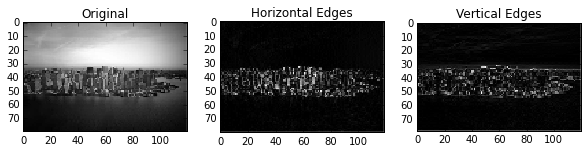

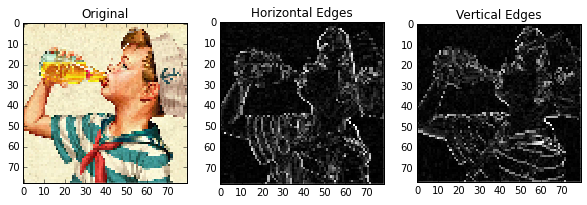

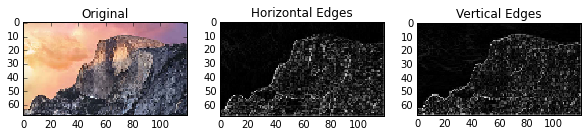

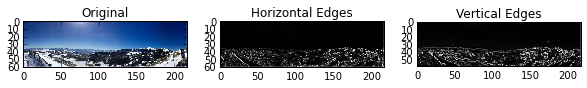

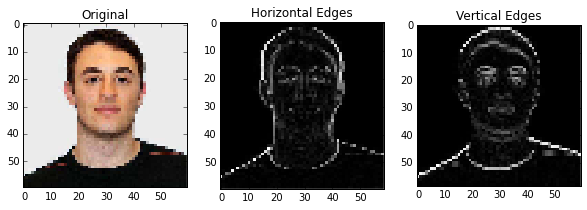

In [21]:
# Apply to image set
for i,img in enumerate(imgset):
    decimg = decimate_image(img, 5) # downsample to make it easier to see graphs
    plt.figure()
    plt.subplot(1, 3, 1)
    plt.title('Original')
    plt.imshow(decimg)
    plt.subplot(1, 3, 2)
    plt.title('Horizontal Edges')
    plt.imshow(find_horizontal_edges(decimg))
    plt.subplot(1, 3, 3)
    plt.title('Vertical Edges')
    plt.imshow(find_vertical_edges(decimg))

## Difference filter pair-wise differences

In [22]:
# Find the absolute difference between two images. Crops to the shared region between images.
# abarba - overlays 2 images, any pixel that is the exact same color becomes black, otherwise it multiples the colors together
def find_pairwise_difference(img_a, img_b):
    subset = np.minimum(img_a.shape, img_b.shape)
    img_a_subset = img_a[:subset[0], :subset[1]]
    img_b_subset = img_b[:subset[0], :subset[1]]
    return img_a_subset, img_b_subset, np.abs(img_a_subset - img_b_subset)

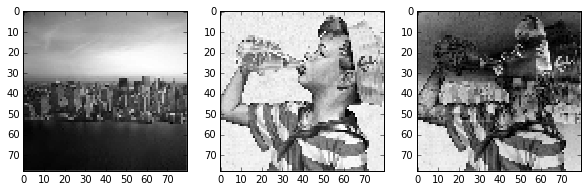

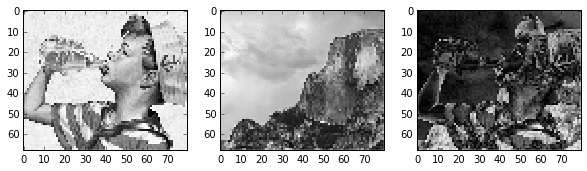

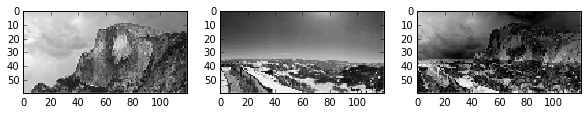

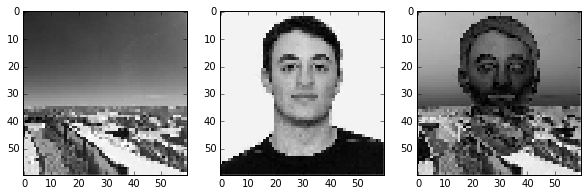

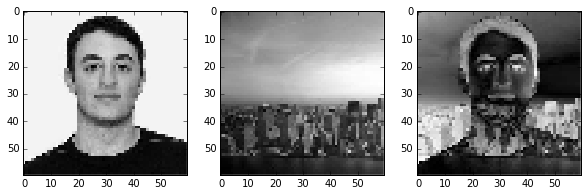

In [23]:
# Apply to image set
for i in range(len(imgset)):
    decimg_a = img_as_float(color.rgb2grey(decimate_image(imgset[i], 5))) # downsample to make it easier to see graphs
    decimg_b = img_as_float(color.rgb2grey(decimate_image(imgset[(i+1) % len(imgset)], 5)))
    a, b, d = find_pairwise_difference(decimg_a, decimg_b)
    plt.figure()
    plt.subplot(1, 3, 1)
    plt.imshow(a)
    plt.subplot(1, 3, 2)
    plt.imshow(b)
    plt.subplot(1, 3, 3)
    plt.imshow(d)

In [24]:
# Find the squared difference between two images. Crops to the shared region between images.
# abarba - pixels with opposite colors become black, others are squared the difference in the values
def find_pairwise_difference_squared(img_a, img_b):
    subset = np.minimum(img_a.shape, img_b.shape)
    img_a_subset = img_a[:subset[0], :subset[1]]
    img_b_subset = img_b[:subset[0], :subset[1]]
    return img_a_subset, img_b_subset, np.square(img_a_subset - img_b_subset)

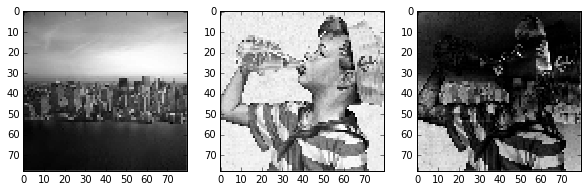

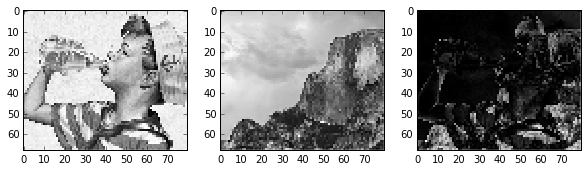

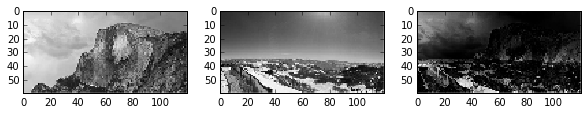

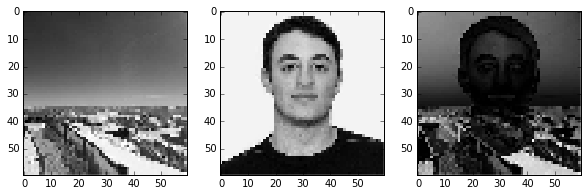

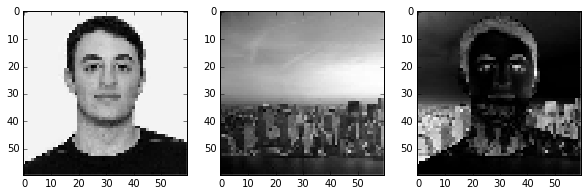

In [25]:
# Apply to image set
for i in range(len(imgset)):
    decimg_a = img_as_float(color.rgb2grey(decimate_image(imgset[i], 5))) # downsample to make it easier to see graphs
    decimg_b = img_as_float(color.rgb2grey(decimate_image(imgset[(i+1) % len(imgset)], 5)))
    a, b, d = find_pairwise_difference_squared(decimg_a, decimg_b)
    plt.figure()
    plt.subplot(1, 3, 1)
    plt.imshow(a)
    plt.subplot(1, 3, 2)
    plt.imshow(b)
    plt.subplot(1, 3, 3)
    plt.imshow(d)

## Feature Detection

### Sobel filter

In [26]:
# Apply a Sobel filter to the image.
# abarba - finds distinct connected paths of pixels. 
# abarba - The more alike each pixel is in the path, the more white the path is. Otherwise it is black.
def apply_sobel(img):
    sobel_kernel = np.array([[-1, 0, +1],[-2, 0, +2],[-1, 0, +1]])
    Gx = convolve(img, sobel_kernel)
    Gy = convolve(img, -sobel_kernel.transpose())
    return np.sqrt(np.square(Gx) + np.square(Gy))

# This should do the same thing as skimage.filters.sobel(img)

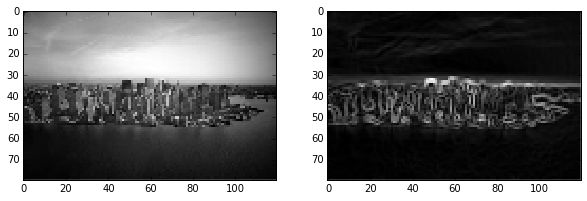

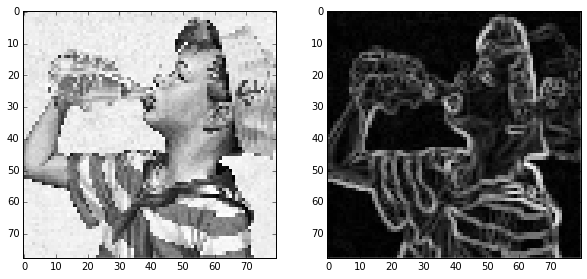

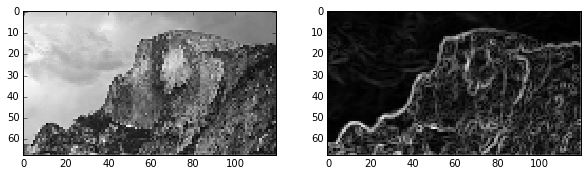

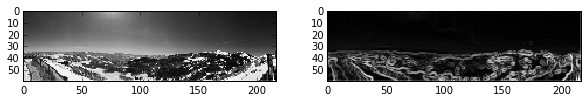

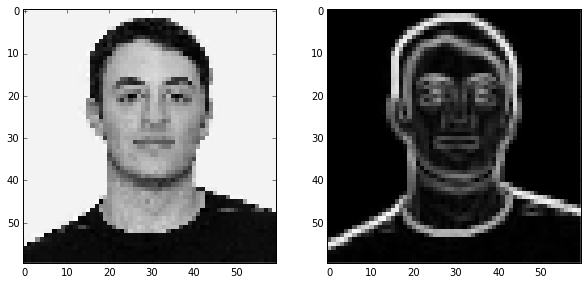

In [27]:
# Apply to image set
for i,img in enumerate(imgset):
    imgbw = img_as_float(color.rgb2grey(decimate_image(img, 5))) # downsample to make it easier to see graphs
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 2, 2)
    plt.imshow(apply_sobel(imgbw))

### Canny edge detector 

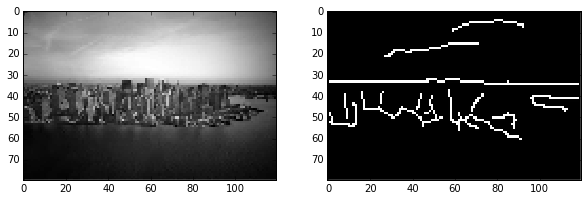

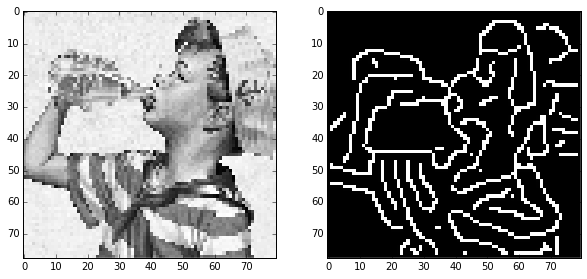

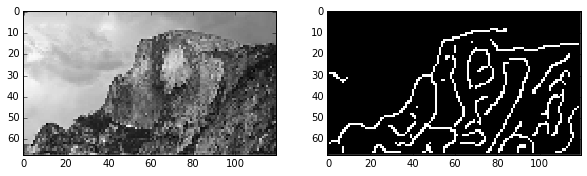

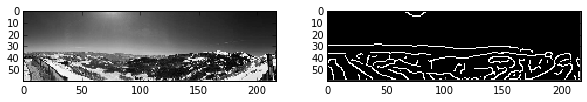

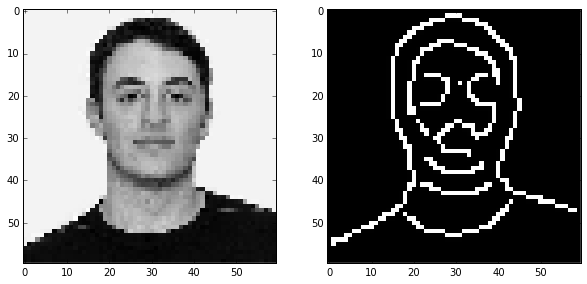

In [28]:
# Apply to image set
sigma = 2.0
for i,img in enumerate(imgset):
    imgbw = img_as_float(color.rgb2grey(decimate_image(img, 5))) # downsample to make it easier to see graphs
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 2, 2)
    plt.imshow(feature.canny(imgbw, sigma))

### Hough transforms

In [29]:
# Plot the circular Hough transforms of an image at the given radii.
def plot_circle_hough(img, radii, sigma):
    edges = feature.canny(img, sigma)
    hough = hough_circle(edges, radii)
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 2, 2)
    plt.imshow(edges)
    plt.figure()
    for j in range(len(hough)):
        if len(hough)==0: continue
        plt.subplot(1, len(hough), j)
        plt.imshow(hough[j,:,:])    

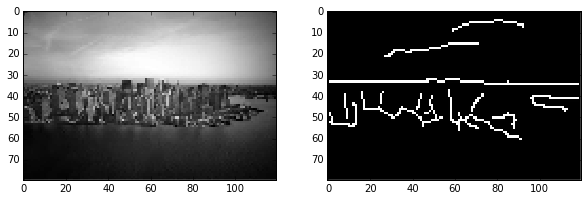

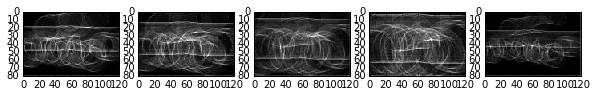

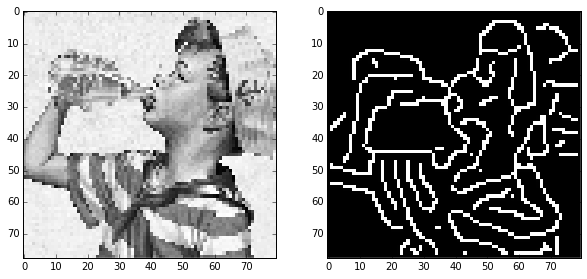

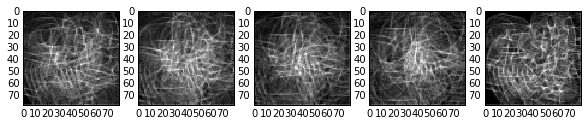

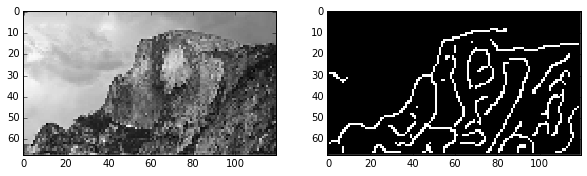

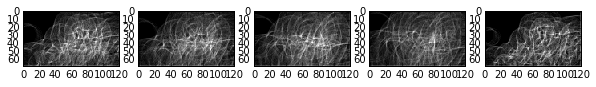

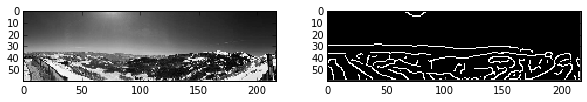

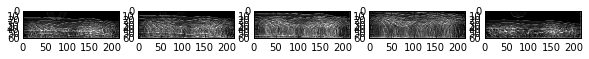

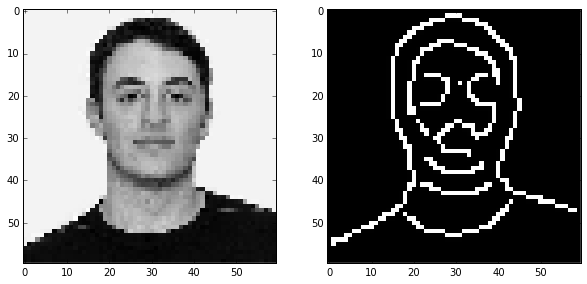

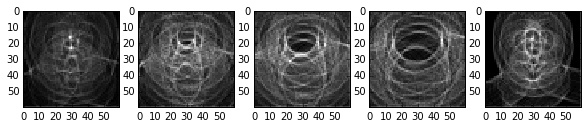

In [79]:
# Apply to image set
radii = np.arange(10, 35, 5)
sigma = 2.0
for i,img in enumerate(imgset):
    imgbw = img_as_float(color.rgb2grey(decimate_image(img, 5))) # downsample to make it easier to see graphs
    plot_circle_hough(imgbw, radii, sigma)

## Morphological Operations

### Morphological operations - de-noising

In [31]:
# Applies a morphological operator to remove noise
def morpho_denoise(img, shape, size):
    if shape == 'square':
        kernel = morphology.square(width=size)
    elif shape == 'diamond':
        kernel = morphology.diamond(radius=size)
    else:
        print("Shape must be 'square' or 'diamond'.")
        return None
    return morphology.opening(img, kernel)

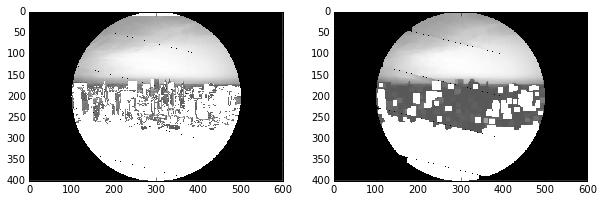

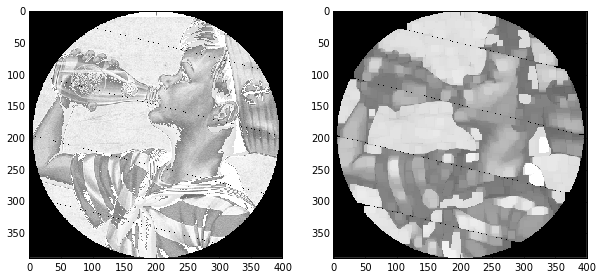

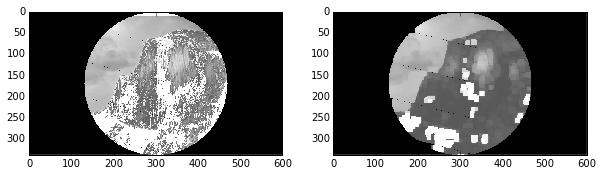

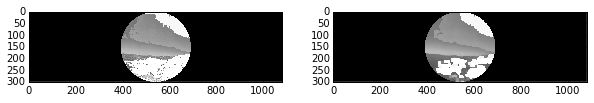

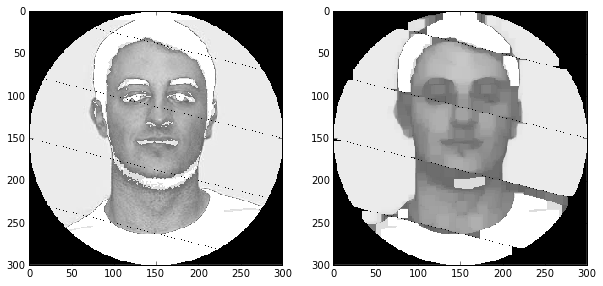

In [179]:
# Apply to image set
# abarba - blurs groups of similar pixels together and maintains a harsh edge
for i,img in enumerate(imgset):
    imgbw = img_as_float(color.rgb2grey(img))
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 2, 2)
    plt.imshow(morpho_denoise(imgbw, 'square', 10))

## Segmentation

### SLIC (Simple Linear Iterative Clustering)

In [33]:
# Calculate the mean color of slic regions, from the SciKit tutorial
def mean_color(image, labels):
    out = np.zeros_like(image)
    for label in np.unique(labels):
        indices = np.nonzero(labels == label)
        out[indices] = np.mean(image[indices], axis=0)
    return out

def plot_slic_segmentation(img):
    labels = seg.slic(img, n_segments=24, compactness=70, sigma=2.0, enforce_connectivity=True)
    return mean_color(img, labels)

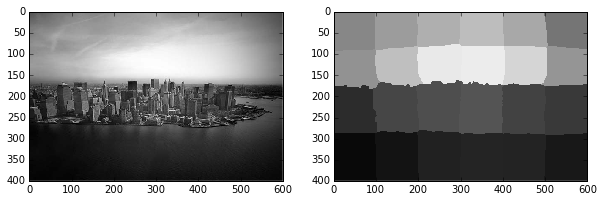

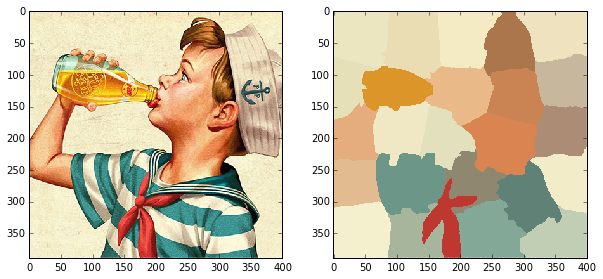

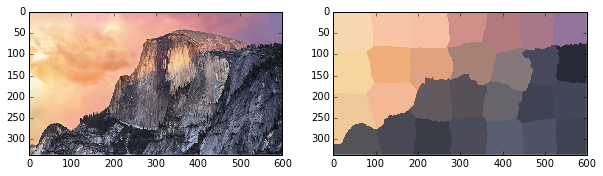

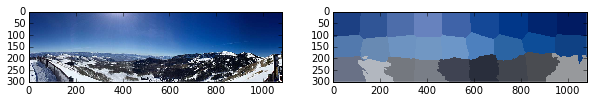

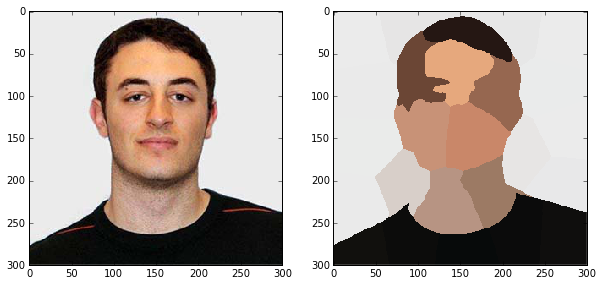

In [34]:
# Apply to the images
for i,img in enumerate(imgset):
    rgbimg = img_as_float(color.gray2rgb(img))
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(plot_slic_segmentation(rgbimg))

### Watershed algorithm

In [35]:
# Show a watershed plot of an image
def plot_watershed(img, sigma):
    edges = feature.canny(img, sigma)
    distance_from_edge = nd.distance_transform_edt(-edges)
    peaks = peak_local_max(distance_from_edge)
    peaks_image = np.zeros(img.shape, np.bool)
    peaks_image[tuple(np.transpose(peaks))] = True
    seeds, num_seeds = nd.label(peaks_image)
    plt.plot(peaks[:, 1], peaks[:, 0], 'ro')
    ws = watershed(edges, seeds)
    plt.imshow(color.label2rgb(ws, img))

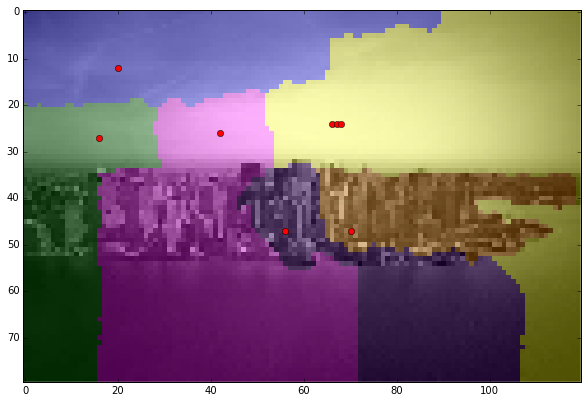

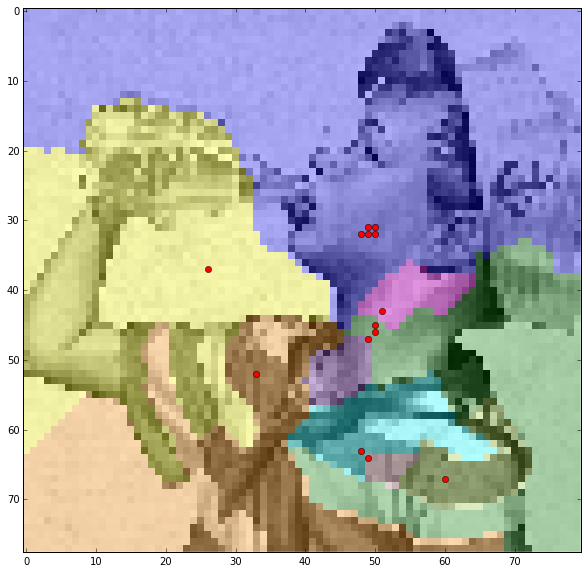

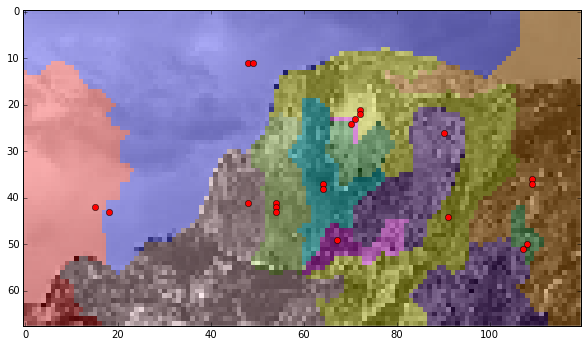

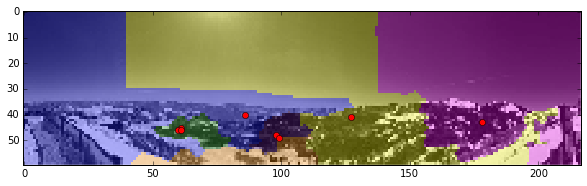

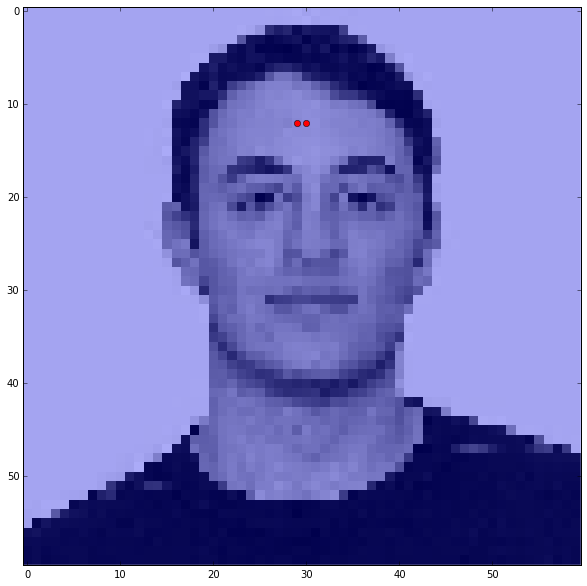

In [36]:
# Apply to the images
for i,img in enumerate(imgset):
    imgbw = (color.rgb2grey(decimate_image(img, 5)))
    plt.figure()
    plot_watershed(imgbw, 1.0)

Part D
===

### Local Maxima

In [183]:
from scipy import ndimage as ndi
import matplotlib.pyplot as plt
from skimage.feature import peak_local_max
from skimage import data, img_as_float

# abarba - uses a function to find the coordinates of peaks in the image
# abarba - dilates the image and merges the peaks together
# abarba - works on all color spaces
def plot_local_maxima(img):
    im = img_as_float(img)

    # image_max is the dilation of im with a 20*20 structuring element
    # It is used within peak_local_max function
    image_max = ndi.maximum_filter(im, size=20, mode='constant')

    # Comparison between image_max and im to find the coordinates of local maxima
    coordinates = peak_local_max(im, min_distance=20)

    # display results
    fig, ax = plt.subplots(1, 3, figsize=(8, 3))
    ax1, ax2, ax3 = ax.ravel()
    ax1.imshow(im, cmap=plt.cm.gray)
    ax1.axis('off')
    ax1.set_title('Original')

    ax2.imshow(image_max, cmap=plt.cm.gray)
    ax2.axis('off')
    ax2.set_title('Maximum filter')

    ax3.imshow(im, cmap=plt.cm.gray)
    ax3.autoscale(False)
    ax3.plot(coordinates[:, 1], coordinates[:, 0], 'r.')
    ax3.axis('off')
    ax3.set_title('Peak local max')

    fig.subplots_adjust(wspace=0.02, hspace=0.02, top=0.9,
                        bottom=0.02, left=0.02, right=0.98)

    plt.show()

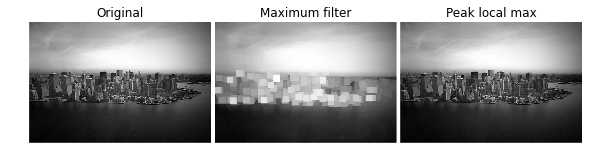

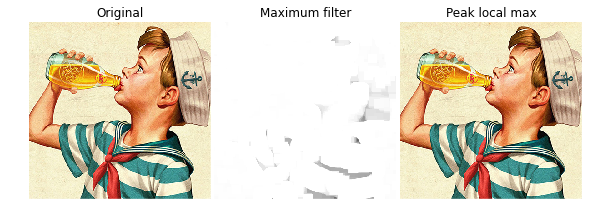

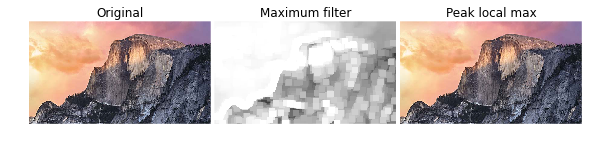

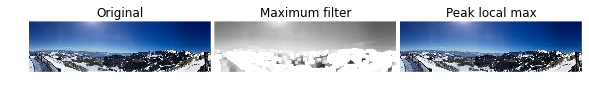

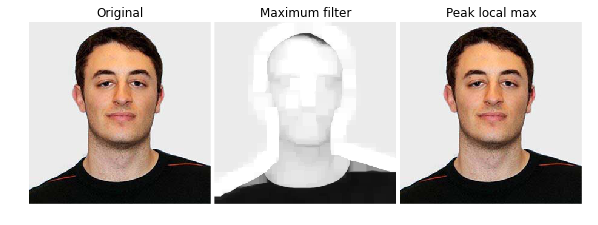

In [184]:
# Apply to the images
for i,img in enumerate(imgset):
    plt.figure()
    plot_local_maxima(img.copy())

### Tint Gray Scale

In [185]:
import matplotlib.pyplot as plt
from skimage import data
from skimage import color
from skimage import img_as_float

# abarba - multiplies each RGB value in a channel by the same value
# abarba - works only on grayscale color spaces
def plot_gray_tint(img):
    grayscale_image = img_as_float(img[::2, ::2])
    image = color.gray2rgb(grayscale_image)

    red_multiplier = [1, 0, 0]
    yellow_multiplier = [1, 1, 0]

    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4))
    ax1.imshow(red_multiplier * image)
    ax2.imshow(yellow_multiplier * image)

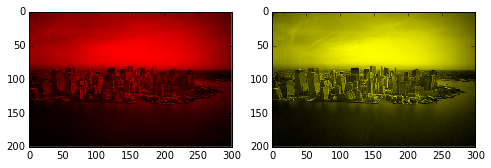

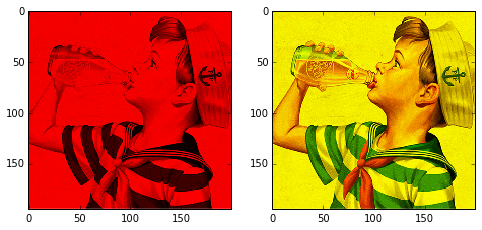

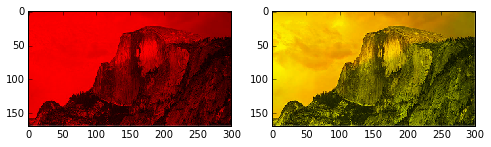

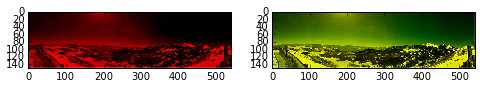

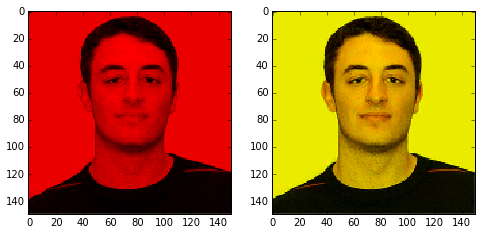

In [186]:
# Apply to the images
for i,img in enumerate(imgset):
    plt.figure()
    plot_gray_tint(img.copy())

### Masking

In [187]:
import numpy as np
from skimage import data
import matplotlib.pyplot as plt

# abarba - masks a shape around each image, turning the pixels not in the coordinate region to black
# abarba - works on all color spaces
def plot_mask(img):
    camera = img
    camera[:10] = 0
    mask = camera < 87
    camera[mask] = 255
    inds_x = np.arange(len(camera))
    inds_y = (4 * inds_x) % len(camera)
    camera[inds_x, inds_y] = 0

    l_x, l_y = camera.shape[0], camera.shape[1]
    X, Y = np.ogrid[:l_x, :l_y]
    outer_disk_mask = (X - l_x / 2)**2 + (Y - l_y / 2)**2 > (l_x / 2)**2
    camera[outer_disk_mask] = 0

    plt.figure(figsize=(4, 4))
    plt.imshow(camera, cmap='gray', interpolation='nearest')
    plt.axis('off')
    plt.show()

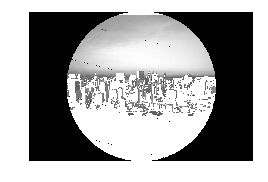

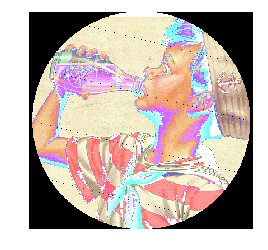

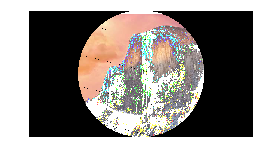

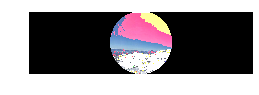

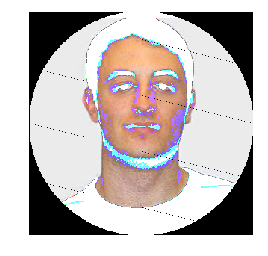

In [188]:
# Apply to the images
for i,img in enumerate(imgset):
    plt.figure()
    plot_mask(img.copy())

### Canny Edge Detector

In [189]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage as ndi

from skimage import feature

# abarba - based on a gausian filter, it reduces the noise in an image and reduces edges to 1 pixel
# abarba - works on only gray-scale color spaces
def plot_canny(img):
    im = img
    
    # Compute the Canny filter for two values of sigma
    edges1 = feature.canny(im)
    edges2 = feature.canny(im, sigma=3)

    # display results
    fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(8, 3))

    ax1.imshow(im, cmap=plt.cm.jet)
    ax1.axis('off')
    ax1.set_title('noisy image', fontsize=20)

    ax2.imshow(edges1, cmap=plt.cm.gray)
    ax2.axis('off')
    ax2.set_title('Canny filter, $\sigma=1$', fontsize=20)

    ax3.imshow(edges2, cmap=plt.cm.gray)
    ax3.axis('off')
    ax3.set_title('Canny filter, $\sigma=3$', fontsize=20)

    fig.subplots_adjust(wspace=0.02, hspace=0.02, top=0.9,
                        bottom=0.02, left=0.02, right=0.98)

    plt.show()

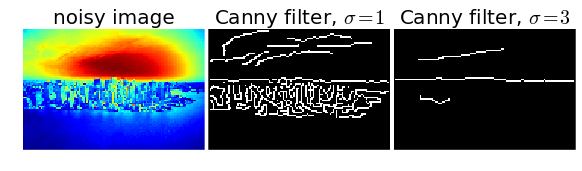

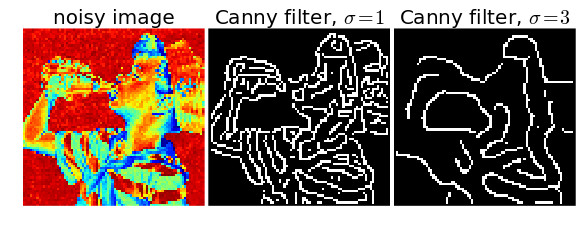

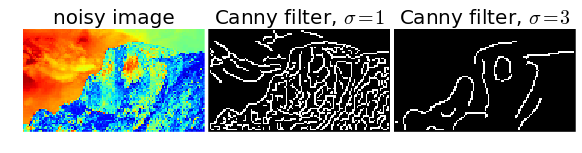

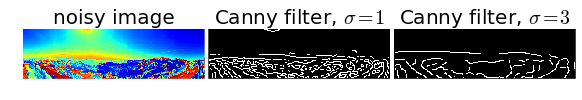

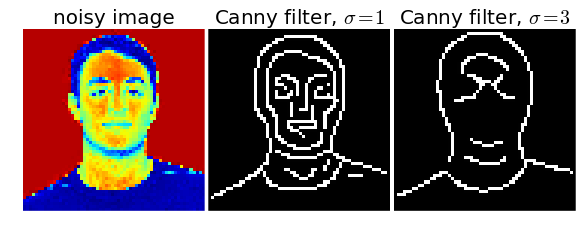

In [190]:
# Apply to the images
for i,img in enumerate(imgset):
    imgbw = (color.rgb2grey(decimate_image(img.copy(), 5)))
    plt.figure()
    plot_canny(imgbw)

### Holes and Peaks

In [191]:
import matplotlib.pyplot as plt

from skimage import data
from skimage.exposure import rescale_intensity
import numpy as np
from skimage.morphology import reconstruction

# abarba - generates two images the represent min and max possible values of the reconstructed image
# abarba - works on all color spaces
def plot_holes_peaks(img):
    image = img
    # Rescale image intensity so that we can see dim features.
    image = rescale_intensity(image, in_range=(50, 200))


    # convenience function for plotting images
    def imshow(image, title, **kwargs):
        fig, ax = plt.subplots(figsize=(5, 4))
        ax.imshow(image, **kwargs)
        ax.axis('off')
        ax.set_title(title)


    imshow(image, 'Original image')
    
    seed = np.copy(image)
    seed[1:-1, 1:-1] = image.max()
    mask = image

    filled = reconstruction(seed, mask, method='erosion')

    imshow(filled, 'after filling holes', vmin=image.min(), vmax=image.max())

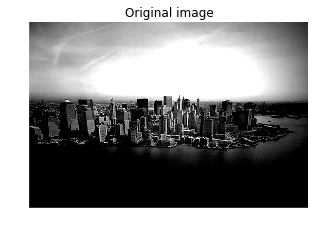

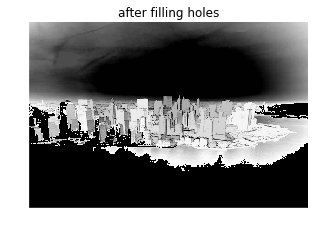

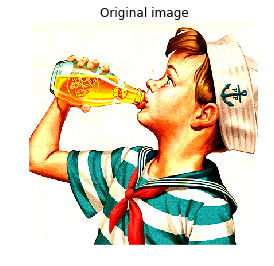

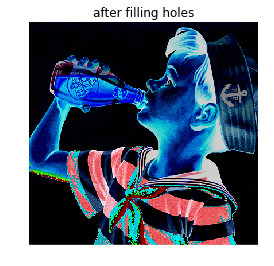

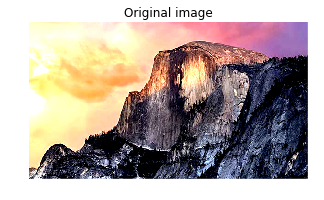

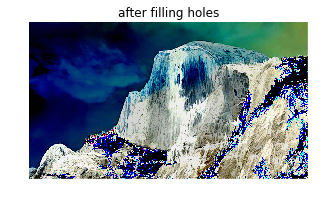

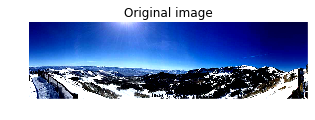

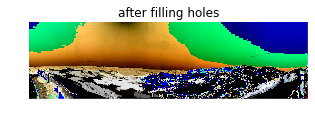

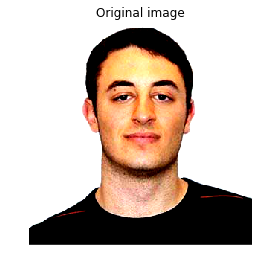

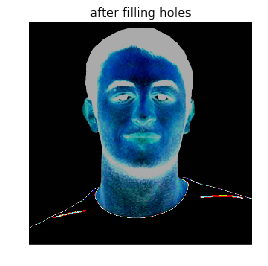

In [192]:
# Apply to the images
for i,img in enumerate(imgset):
    plt.figure()
    plot_holes_peaks(img.copy())

### Contours

In [193]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import measure

# abarba - uses marching squares method to find contours
# abarba - works only on gray-scale color spaces
def plot_contour(img):
    # Construct some test data
    x, y = np.ogrid[-np.pi:np.pi:100j, -np.pi:np.pi:100j]
    r = np.sin(np.exp((np.sin(x)**3 + np.cos(y)**2)))

    # Find contours at a constant value of 0.8
    contours = measure.find_contours(img, 0.8)

    # Display the image and plot all contours found
    fig, ax = plt.subplots()
    ax.imshow(r, interpolation='nearest', cmap=plt.cm.gray)

    for n, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

    ax.axis('image')
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()

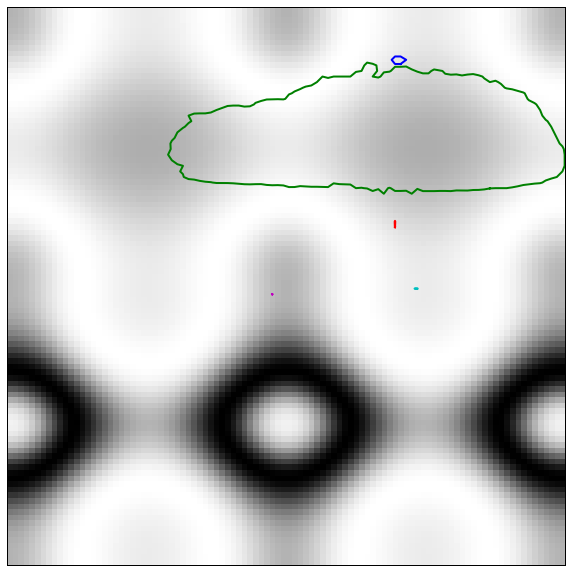

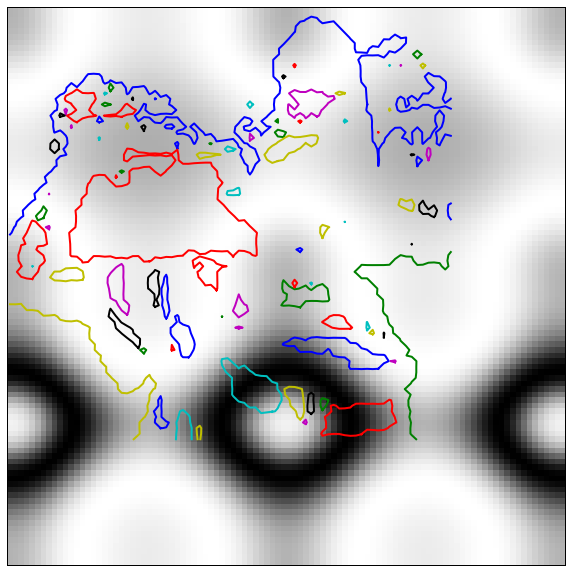

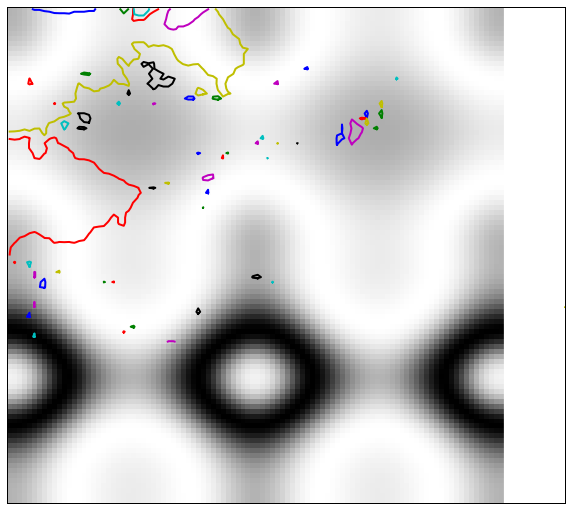

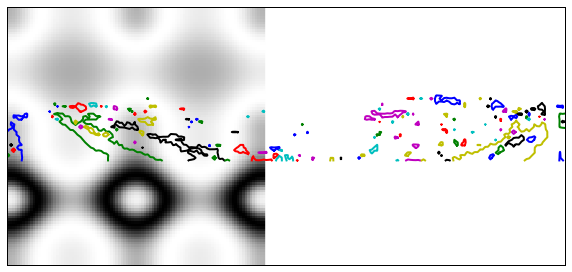

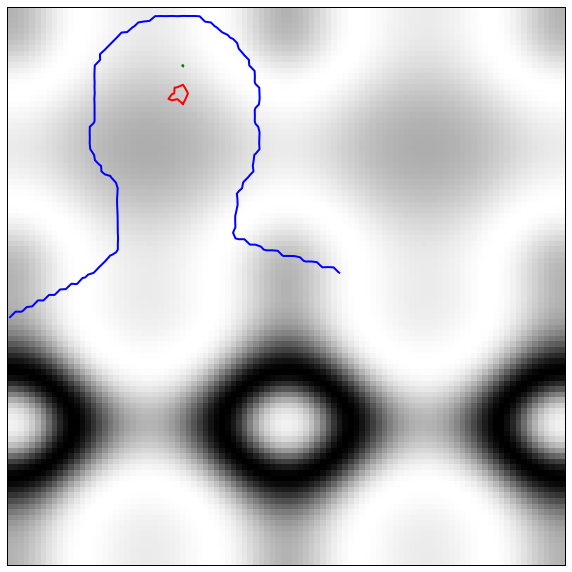

In [194]:
# Apply to the images
for i,img in enumerate(imgset):
    imgbw = (color.rgb2grey(decimate_image(img.copy(), 5)))
    plt.figure()
    plot_contour(imgbw)

### Rag Thresholding

In [195]:
from skimage import data, io, segmentation, color
from skimage.future import graph
from matplotlib import pyplot as plt

# abarba - merges pixel regions that share similar colors
# abarba - works on all color spaces
def plot_rag(img):
    labels1 = segmentation.slic(img, compactness=30, n_segments=400)
    out1 = color.label2rgb(labels1, img, kind='avg')

    g = graph.rag_mean_color(img, labels1)
    labels2 = graph.cut_threshold(labels1, g, 29)
    out2 = color.label2rgb(labels2, img, kind='avg')

    plt.figure()
    io.imshow(out1)
    plt.figure()
    io.imshow(out2)
    io.show()

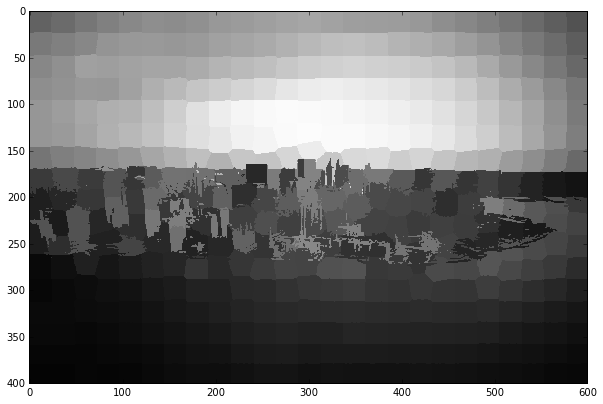

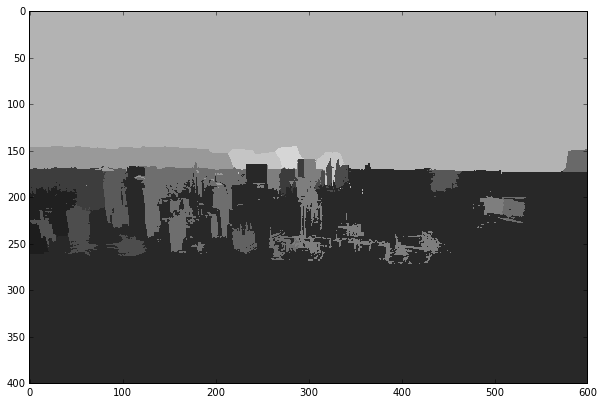

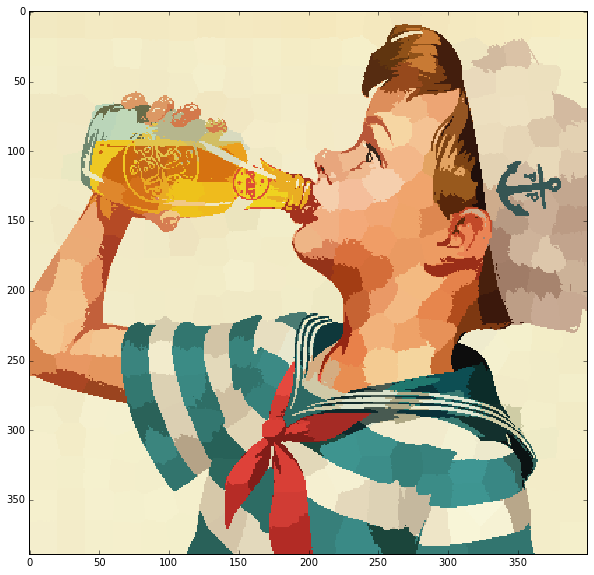

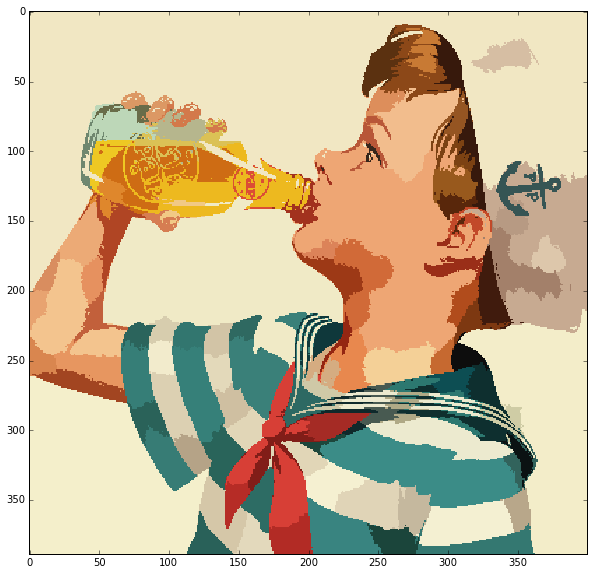

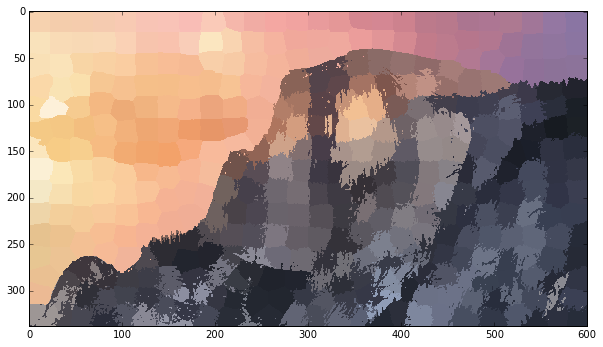

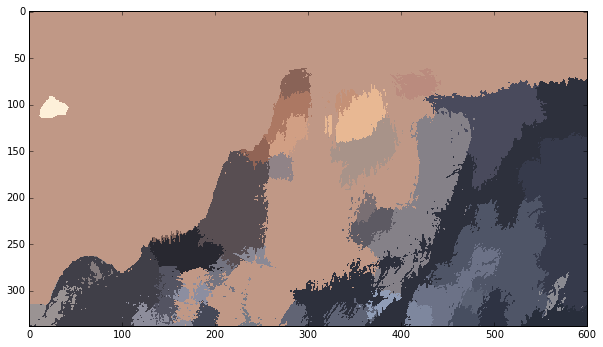

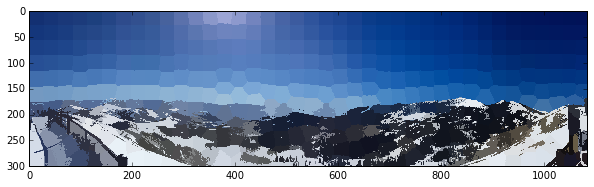

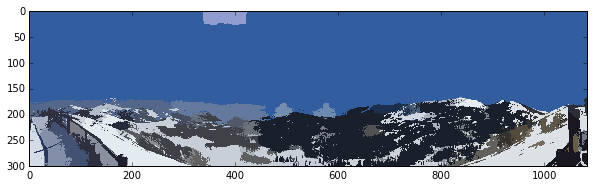

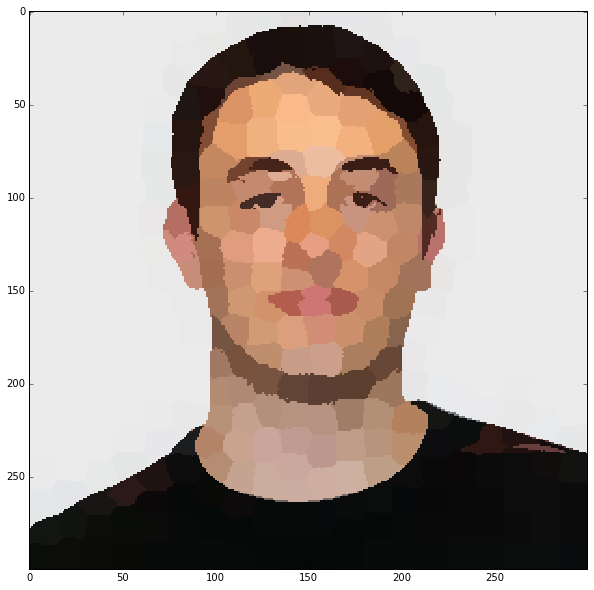

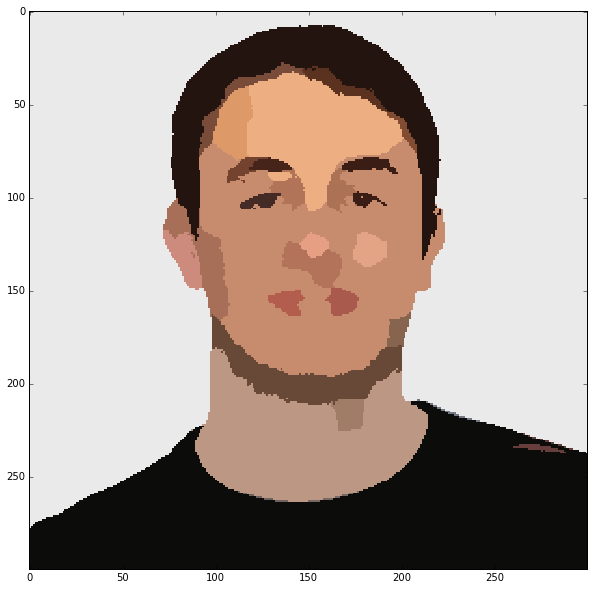

In [196]:
# Apply to the images
for i,img in enumerate(imgset):
    plt.figure()
    plot_rag(img.copy())

### DAISY

In [197]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import PiecewiseAffineTransform, warp
from skimage import data

# abarba - translates pixels on the left and right downward and pixels in the center upward
# abarba - follows a sin like curve for the translation
# abarba - works on all color spaces
def plot_affine(img):
    image = img
    rows, cols = image.shape[0], image.shape[1]

    src_cols = np.linspace(0, cols, 20)
    src_rows = np.linspace(0, rows, 10)
    src_rows, src_cols = np.meshgrid(src_rows, src_cols)
    src = np.dstack([src_cols.flat, src_rows.flat])[0]

    # add sinusoidal oscillation to row coordinates
    dst_rows = src[:, 1] - np.sin(np.linspace(0, 3 * np.pi, src.shape[0])) * 50
    dst_cols = src[:, 0]
    dst_rows *= 1.5
    dst_rows -= 1.5 * 50
    dst = np.vstack([dst_cols, dst_rows]).T


    tform = PiecewiseAffineTransform()
    tform.estimate(src, dst)

    out_rows = image.shape[0] - 1.5 * 50
    out_cols = cols
    out = warp(image, tform, output_shape=(out_rows, out_cols))

    fig, ax = plt.subplots()
    ax.imshow(out)
    ax.plot(tform.inverse(src)[:, 0], tform.inverse(src)[:, 1], '.b')
    ax.axis((0, out_cols, out_rows, 0))
    plt.show()

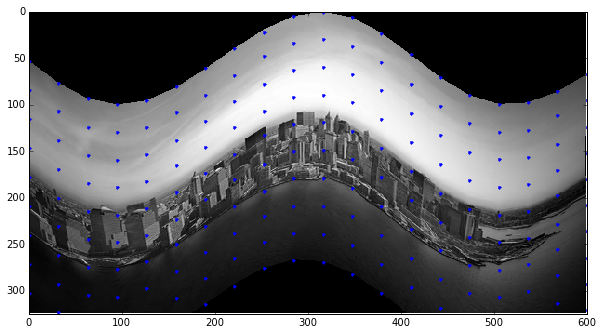

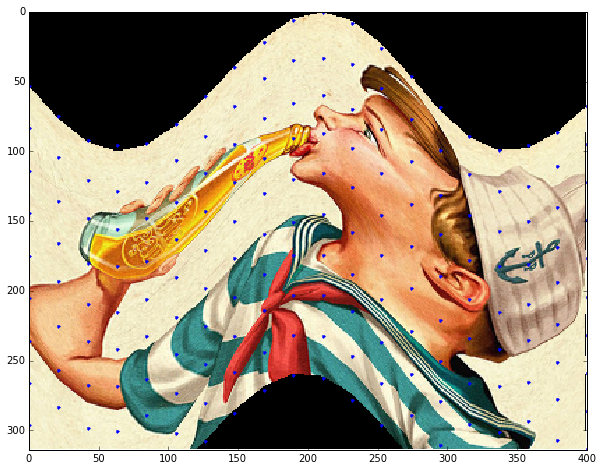

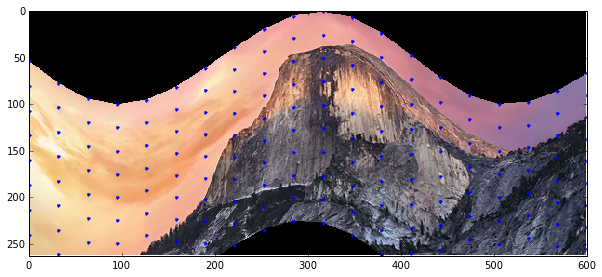

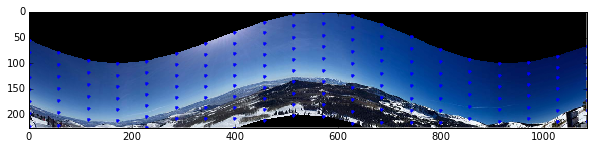

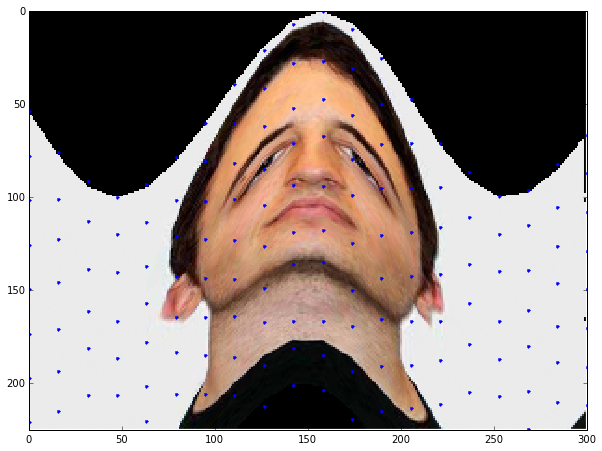

In [198]:
# Apply to the images
for i,img in enumerate(imgset):
    plt.figure()
    plot_affine(img.copy())